In [17]:
!pip install pycocotools

In [1]:
import os
import numpy as np
import pandas as pd
from glob import glob
import cv2
import torch
from torch.utils.data import Dataset
from torch.utils import data
from PIL import Image
import torchvision
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision import transforms
import matplotlib.pyplot as plt
from tqdm import tqdm

In [2]:
num_classes=44
classes = { 0:' Speed limit (20km/h)' ,1:' Speed limit (30km/h)' ,2:' Speed limit (50km/h)' ,
    3:' Speed limit (60km/h)' ,4:' Speed limit (70km/h)' ,5:' Speed limit (80km/h)' ,6:' End of speed limit (80km/h)' ,
    7:' Speed limit (100km/h)' ,8:' Speed limit (120km/h)' ,9:' No passing' ,
    10:' No passing veh over 3.5 tons' ,11:' Right-of-way at intersection' ,12:' Priority road' ,13:' Yield' ,
    14:' Stop' ,15:' No vehicles' ,16:' Veh > 3.5 tons prohibited' ,17:' No entry' ,18:' General caution' ,
    19:' Dangerous curve left' ,20:' Dangerous curve right' ,21:' Double curve' ,22:' Bumpy road' ,23:' Slippery road' ,
    24:' Road narrows on the right' ,25:' Road work' ,26:' Traffic signals' ,27:' Pedestrians' ,
           28:' Children crossing' ,29:' Bicycles crossing' ,30:' Beware of ice/snow' ,
    31:' Wild animals crossing' ,32:' End speed + passing limits' ,33:' Turn right ahead' ,34:' Turn left ahead' ,
    35:' Ahead only' ,36:' Go straight or right' ,37:' Go straight or left' ,38:' Keep right' ,
    39:' Keep left' ,40:' Roundabout mandatory' ,41:' End of no passing' ,42:' End no passing veh > 3.5 tons' 
          }
    

In [3]:
gt_data = pd.read_csv('../train/gt.txt', delimiter = ';', header = None)
bb_data = {}
for i,row in gt_data.iterrows():
    img_file = row[0]
    l = list([row[1], row[2], row[3], row[4], row[5]])
    bb_data.setdefault(img_file, []).append(l)

In [4]:
import shutil
src_folder = "../train/images"
dst_folder = "../train/images_all"

for filename in list(bb_data):
    src_path = os.path.join(src_folder, filename)
    dst_path = os.path.join(dst_folder, filename)
    shutil.copy(src_path, dst_path)
print(len(glob('../train/images_all/*.ppm')))

506


In [5]:
from engine import train_one_epoch, evaluate
import utilss
class load_dataset(Dataset):
    def __init__(self, root, transforms):
        self.root = root
        self.transforms = transforms
        self.imgs = list(sorted(os.listdir(os.path.join(root, "images_all"))))

    def __getitem__(self, idx):
        img_path = os.path.join(self.root, "images_all", self.imgs[idx])
        img = Image.open(img_path).convert("RGB")
        objects = bb_data[self.imgs[idx]]
        boxes = []
        labels = []
        for obj in objects:
            name = int(obj[4])
            labels.append(int(name))
            xmin = float(obj[0])
            ymin = float(obj[1])
            xmax = float(obj[2])
            ymax = float(obj[3])
            boxes.append([xmin, ymin, xmax, ymax])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)        
 
        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        iscrowd = torch.zeros((len(objects),), dtype=torch.int64)
        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])

        target = {}
        target["boxes"] = boxes
        target['labels'] = labels
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd

        if self.transforms is not None:
            img, target = self.transforms(img, target)

        return img, target

    def __len__(self):
        return len(self.imgs)

In [6]:
from torchvision.models import ResNet50_Weights
def get_model():
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights = None, progress=True, num_classes=num_classes, weights_backbone = ResNet50_Weights.IMAGENET1K_V1)
    device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
    model.to(device)
    return model

In [7]:
def image_w_bounding_box(img,boxes,labels,scores):
    img = img.permute(1,2,0) 
    img = (img * 255).byte().data.cpu() 
    img = np.array(img)
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    boxes = boxes.cpu().numpy().astype(np.float32)
    labels = labels.cpu().numpy().astype(np.int64)
    scores = scores.cpu().numpy().astype(np.float32)
    for i,box in enumerate(boxes):
        xmin = int(round(box[0]))
        ymin = int(round(box[1]))
        xmax = int(round(box[2]))
        ymax = int(round(box[3]))
        label = labels[i]
        score = str(round(scores[i],2))
        color = (0,255,0)
        pt1 = (xmin, ymin)
        pt2 = (xmax, ymax)
        cv2.rectangle(img, pt1, pt2, color, thickness=2)
        cv2.putText(img, classes[label]+"-"+ score, (xmin-15, ymin-7), cv2.FONT_HERSHEY_SIMPLEX, 0.7, color,
                        thickness=2)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(40,35))
    plt.imshow(img)

In [8]:
import transforms as T

def get_transform(train):
    transforms = []
    transforms.append(T.ToTensor())
    if train:
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

In [9]:
dataset = load_dataset('../train', get_transform(train=True))

In [10]:
class_freq = [0 for _ in range(num_classes-1) ]
train_size = 506
for i in tqdm(range(train_size), desc = 'Calculating..'):
    _,target = dataset[i]
    c_classes = target['labels'].numpy()
    for c_class in c_classes:
        class_freq[c_class] += 1
c_classes = [i for i in range(num_classes-1)]

Calculating..: 100%|██████████| 506/506 [00:24<00:00, 20.59it/s]


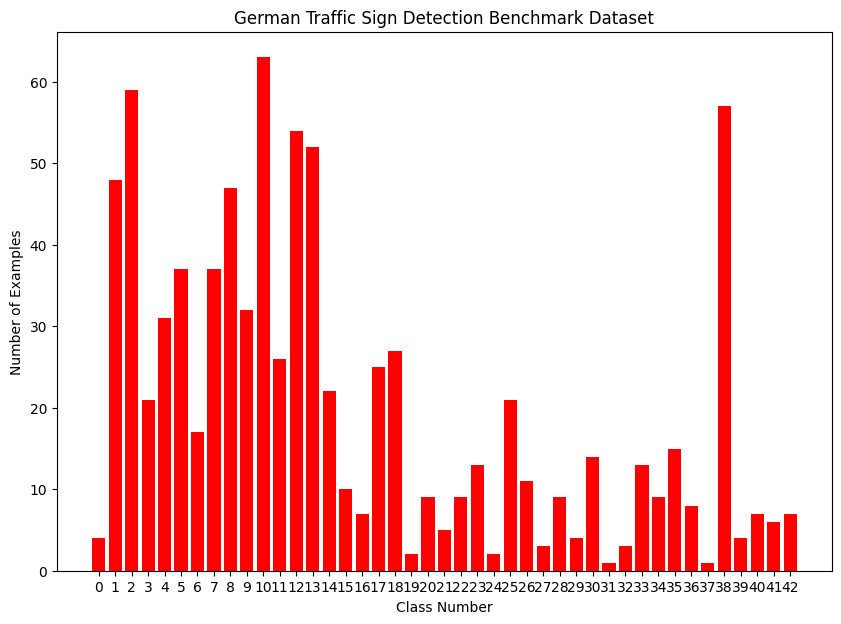

In [11]:
plt.figure(figsize=(10,7))
plt.bar(c_classes, class_freq, color='red')
plt.xlabel("Class Number")
plt.ylabel("Number of Examples")
plt.title("German Traffic Sign Detection Benchmark Dataset")
plt.xticks(c_classes)
plt.show()

In [12]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

dataset = load_dataset('../train', get_transform(train=True))
dataset_test = load_dataset('../train', get_transform(train=False))

indices = torch.randperm(len(dataset)).tolist()
dataset = torch.utils.data.Subset(dataset, indices[:-50])
dataset_test = torch.utils.data.Subset(dataset_test, indices[-50:])

data_loader = torch.utils.data.DataLoader(dataset, batch_size=2, shuffle=True,
    collate_fn=utilss.collate_fn)

data_loader_test = torch.utils.data.DataLoader(dataset_test, batch_size=1, shuffle=False,
    collate_fn=utilss.collate_fn)

{'boxes': tensor([[1054.,  392., 1083.,  422.],
        [1131.,  357., 1182.,  408.]]), 'labels': tensor([ 2, 12]), 'image_id': tensor([275]), 'area': tensor([ 870., 2601.]), 'iscrowd': tensor([0, 0])}


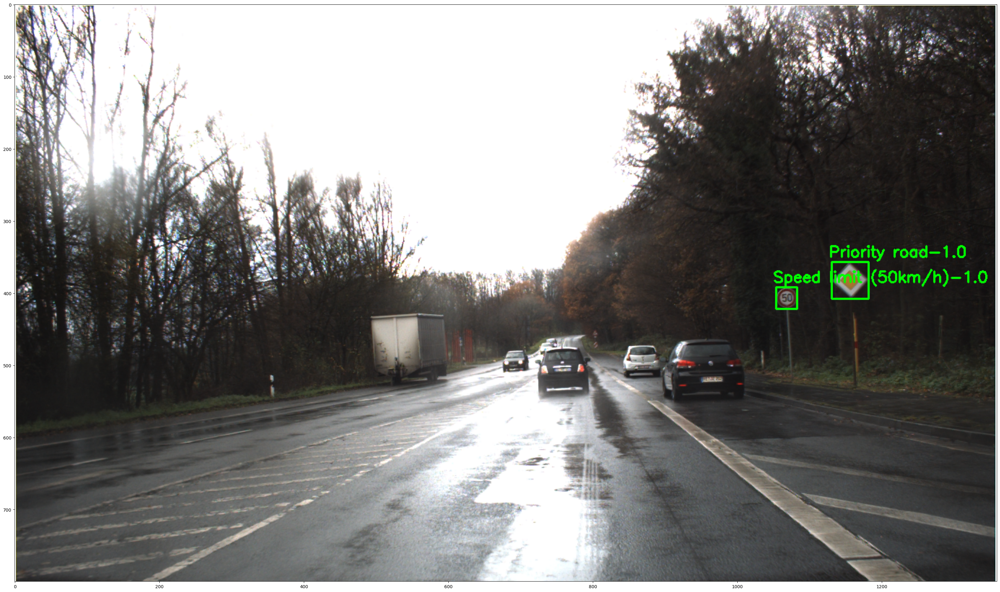

In [15]:
img,target = dataset_test[10]
print(target)
image_w_bounding_box(img, target['boxes'],target['labels'],torch.Tensor([1 for i in range(len(target['labels']))]).to(device))

In [16]:
import pickle
#Get a new model
'''
model = get_model()
model.to(device)
losses = []
box_reg_loss = []
rpn_box_reg_loss = []
classifier_loss = []
objectness_loss = []
'''
#Get a pretrained mode already saved in the dataset
if torch.cuda.is_available():
    model = torch.load(r'../Saved_Model/train1000.pkl')
    model.load_state_dict(torch.load('../Saved_Model/train1000.pth'))
else:
    model = torch.load(r'../Saved_Model/train1000.pkl',map_location=torch.device('cpu'))
    model.load_state_dict(torch.load('../Saved_Model/train1000.pth',map_location=torch.device('cpu')))
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)
print("Model loaded!")
#loding losses
with open('../Saved_Model/vars1000.pickle', 'rb') as f:
    losses , box_reg_loss , rpn_box_reg_loss , classifier_loss , objectness_loss = pickle.load(f)

Model loaded!


In [20]:
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.0005,momentum=0.9, weight_decay=0.0005)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=1, T_mult=2)
num_epochs = 352

for epoch in tqdm(range(num_epochs)):
    metrics = train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=50)
    losses.append(float(str(metrics.meters['loss']).split(" ")[0]))
    box_reg_loss.append(float(str(metrics.meters['loss_box_reg']).split(" ")[0]))
    rpn_box_reg_loss.append(float(str(metrics.meters['loss_rpn_box_reg']).split(" ")[0]))
    classifier_loss.append(float(str(metrics.meters['loss_classifier']).split(" ")[0]))
    objectness_loss.append(float(str(metrics.meters['loss_objectness']).split(" ")[0]))
    lr_scheduler.step()
    evaluate(model, data_loader_test, device=device)
    if epoch % 50 == 0:
        torch.save({
        'epoch' : epoch,
        "model_state_dict" : model.state_dict(),
        'optimizer_state_dict' : optimizer.state_dict(),}, 'checkpoint.pth')

print("That's it!")

  0%|          | 0/352 [00:00<?, ?it/s]

Epoch: [0]  [  0/228]  eta: 0:16:52  lr: 0.000003  loss: 0.0095 (0.0095)  loss_classifier: 0.0050 (0.0050)  loss_box_reg: 0.0043 (0.0043)  loss_objectness: 0.0000 (0.0000)  loss_rpn_box_reg: 0.0002 (0.0002)  time: 4.4420  data: 0.0334  max mem: 2581
Epoch: [0]  [ 50/228]  eta: 0:01:16  lr: 0.000113  loss: 0.0342 (0.0689)  loss_classifier: 0.0125 (0.0392)  loss_box_reg: 0.0189 (0.0198)  loss_objectness: 0.0000 (0.0087)  loss_rpn_box_reg: 0.0003 (0.0012)  time: 0.3519  data: 0.0288  max mem: 2843
Epoch: [0]  [100/228]  eta: 0:00:50  lr: 0.000223  loss: 0.0252 (0.0617)  loss_classifier: 0.0102 (0.0345)  loss_box_reg: 0.0148 (0.0212)  loss_objectness: 0.0001 (0.0049)  loss_rpn_box_reg: 0.0004 (0.0010)  time: 0.3482  data: 0.0242  max mem: 2843
Epoch: [0]  [150/228]  eta: 0:00:29  lr: 0.000333  loss: 0.0287 (0.0604)  loss_classifier: 0.0102 (0.0340)  loss_box_reg: 0.0161 (0.0220)  loss_objectness: 0.0001 (0.0035)  loss_rpn_box_reg: 0.0005 (0.0009)  time: 0.3543  data: 0.0286  max mem: 2843


  0%|          | 1/352 [01:34<9:13:52, 94.68s/it]

Epoch: [1]  [  0/228]  eta: 0:01:23  lr: 0.000500  loss: 0.1122 (0.1122)  loss_classifier: 0.0762 (0.0762)  loss_box_reg: 0.0353 (0.0353)  loss_objectness: 0.0001 (0.0001)  loss_rpn_box_reg: 0.0006 (0.0006)  time: 0.3663  data: 0.0436  max mem: 2843
Epoch: [1]  [ 50/228]  eta: 0:01:03  lr: 0.000500  loss: 0.0452 (0.0688)  loss_classifier: 0.0180 (0.0355)  loss_box_reg: 0.0193 (0.0294)  loss_objectness: 0.0004 (0.0030)  loss_rpn_box_reg: 0.0003 (0.0009)  time: 0.3534  data: 0.0285  max mem: 2843
Epoch: [1]  [100/228]  eta: 0:00:45  lr: 0.000500  loss: 0.0471 (0.0669)  loss_classifier: 0.0164 (0.0318)  loss_box_reg: 0.0268 (0.0323)  loss_objectness: 0.0003 (0.0018)  loss_rpn_box_reg: 0.0006 (0.0009)  time: 0.3540  data: 0.0286  max mem: 2843
Epoch: [1]  [150/228]  eta: 0:00:27  lr: 0.000500  loss: 0.0635 (0.0741)  loss_classifier: 0.0216 (0.0371)  loss_box_reg: 0.0348 (0.0336)  loss_objectness: 0.0002 (0.0022)  loss_rpn_box_reg: 0.0012 (0.0011)  time: 0.3553  data: 0.0291  max mem: 2843


  1%|          | 2/352 [03:06<9:01:11, 92.77s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0726)  evaluator_time: 0.0017 (0.0021)  time: 0.0864  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0887 s / it)
Averaged stats: model_time: 0.0715 (0.0726)  evaluator_time: 0.0017 (0.0021)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.806
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.944
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.910
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.783
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.756
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.822
 Average Recall     (AR) @[ IoU=0.50:0.

  1%|          | 3/352 [04:36<8:53:56, 91.79s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0720)  evaluator_time: 0.0017 (0.0019)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0715 (0.0720)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.948
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.948
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.901
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.789
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.859
 Average Recall     (AR) @[ IoU=0.50:0.

  1%|          | 4/352 [06:07<8:49:22, 91.27s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0017 (0.0018)  time: 0.0869  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.815
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.902
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.755
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.

  1%|▏         | 5/352 [07:37<8:46:34, 91.05s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0882  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0718 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.959
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.767
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.834
 Average Recall     (AR) @[ IoU=0.50:0.

  2%|▏         | 6/352 [09:08<8:43:55, 90.85s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0866  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0716 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.860
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.920
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.870
 Average Recall     (AR) @[ IoU=0.50:0.

  2%|▏         | 7/352 [10:38<8:41:02, 90.62s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0018)  time: 0.0865  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.928
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.975
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.807
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.879
 Average Recall     (AR) @[ IoU=0.50:0.

  2%|▏         | 8/352 [12:10<8:42:17, 91.10s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0721)  evaluator_time: 0.0017 (0.0018)  time: 0.0877  data: 0.0111  max mem: 2843
Test: Total time: 0:00:04 (0.0883 s / it)
Averaged stats: model_time: 0.0719 (0.0721)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.905
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.781
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.849
 Average Recall     (AR) @[ IoU=0.50:0.

  3%|▎         | 9/352 [13:40<8:39:03, 90.80s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0729)  evaluator_time: 0.0019 (0.0020)  time: 0.0909  data: 0.0120  max mem: 2843
Test: Total time: 0:00:04 (0.0901 s / it)
Averaged stats: model_time: 0.0716 (0.0729)  evaluator_time: 0.0019 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.898
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.789
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.860
 Average Recall     (AR) @[ IoU=0.50:0.

  3%|▎         | 10/352 [15:10<8:36:17, 90.58s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0016 (0.0018)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0884 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.959
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.924
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.903
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.760
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.

  3%|▎         | 11/352 [16:41<8:34:28, 90.52s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0016 (0.0018)  time: 0.0871  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0884 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.861
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.888
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.872
 Average Recall     (AR) @[ IoU=0.50:0.

  3%|▎         | 12/352 [18:12<8:33:49, 90.67s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0720)  evaluator_time: 0.0016 (0.0018)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0717 (0.0720)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.874
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.914
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.868
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.810
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.880
 Average Recall     (AR) @[ IoU=0.50:0.

  4%|▎         | 13/352 [19:42<8:32:26, 90.70s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0724)  evaluator_time: 0.0018 (0.0019)  time: 0.0889  data: 0.0112  max mem: 2843
Test: Total time: 0:00:04 (0.0881 s / it)
Averaged stats: model_time: 0.0720 (0.0724)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.875
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.815
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.887
 Average Recall     (AR) @[ IoU=0.50:0.

  4%|▍         | 14/352 [21:13<8:31:14, 90.75s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0750)  evaluator_time: 0.0017 (0.0018)  time: 0.0876  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0915 s / it)
Averaged stats: model_time: 0.0719 (0.0750)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.897
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.928
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.888
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.905
 Average Recall     (AR) @[ IoU=0.50:0.

  4%|▍         | 15/352 [22:45<8:31:18, 91.03s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0720)  evaluator_time: 0.0016 (0.0018)  time: 0.0868  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0718 (0.0720)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.16s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.900
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.921
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.900
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.906
 Average Recall     (AR) @[ IoU=0.50:0.

  5%|▍         | 16/352 [24:16<8:29:18, 90.95s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0727)  evaluator_time: 0.0019 (0.0020)  time: 0.0890  data: 0.0116  max mem: 2843
Test: Total time: 0:00:04 (0.0891 s / it)
Averaged stats: model_time: 0.0719 (0.0727)  evaluator_time: 0.0019 (0.0020)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.769
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.835
 Average Recall     (AR) @[ IoU=0.50:0.

  5%|▍         | 17/352 [25:47<8:28:25, 91.06s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)  time: 0.0865  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.791
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.750
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.818
 Average Recall     (AR) @[ IoU=0.50:0.

  5%|▌         | 18/352 [27:18<8:26:49, 91.05s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)  time: 0.0869  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.759
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.830
 Average Recall     (AR) @[ IoU=0.50:0.

  5%|▌         | 19/352 [28:50<8:26:08, 91.20s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0720)  evaluator_time: 0.0017 (0.0018)  time: 0.0870  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0717 (0.0720)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.894
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.863
 Average Recall     (AR) @[ IoU=0.50:0.

  6%|▌         | 20/352 [30:21<8:24:42, 91.21s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0882  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0883 s / it)
Averaged stats: model_time: 0.0718 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.760
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.832
 Average Recall     (AR) @[ IoU=0.50:0.

  6%|▌         | 21/352 [31:53<8:23:54, 91.34s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0720)  evaluator_time: 0.0017 (0.0018)  time: 0.0871  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0718 (0.0720)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.953
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.865
 Average Recall     (AR) @[ IoU=0.50:0.

  6%|▋         | 22/352 [33:24<8:22:44, 91.41s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0724)  evaluator_time: 0.0017 (0.0019)  time: 0.0874  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0893 s / it)
Averaged stats: model_time: 0.0718 (0.0724)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.895
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.781
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.853
 Average Recall     (AR) @[ IoU=0.50:0.

  7%|▋         | 23/352 [34:56<8:21:23, 91.44s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0018)  time: 0.0876  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.868
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.871
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.803
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.874
 Average Recall     (AR) @[ IoU=0.50:0.

  7%|▋         | 24/352 [36:27<8:20:00, 91.46s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0724 (0.0739)  evaluator_time: 0.0017 (0.0022)  time: 0.0881  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0917 s / it)
Averaged stats: model_time: 0.0724 (0.0739)  evaluator_time: 0.0017 (0.0022)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.874
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.953
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.902
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.878
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.809
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.880
 Average Recall     (AR) @[ IoU=0.50:0.

  7%|▋         | 25/352 [37:59<8:19:39, 91.68s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0724)  evaluator_time: 0.0017 (0.0018)  time: 0.0879  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0890 s / it)
Averaged stats: model_time: 0.0721 (0.0724)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.953
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.912
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.889
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.891
 Average Recall     (AR) @[ IoU=0.50:0.

  7%|▋         | 26/352 [39:31<8:18:05, 91.67s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0725)  evaluator_time: 0.0017 (0.0019)  time: 0.0887  data: 0.0111  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0720 (0.0725)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.953
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.905
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.816
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.890
 Average Recall     (AR) @[ IoU=0.50:0.

  8%|▊         | 27/352 [41:03<8:16:23, 91.64s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0725)  evaluator_time: 0.0017 (0.0018)  time: 0.0876  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0720 (0.0725)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.907
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.814
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.888
 Average Recall     (AR) @[ IoU=0.50:0.

  8%|▊         | 28/352 [42:34<8:15:00, 91.67s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0724)  evaluator_time: 0.0016 (0.0018)  time: 0.0876  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0887 s / it)
Averaged stats: model_time: 0.0720 (0.0724)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.897
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.953
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.927
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.899
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.903
 Average Recall     (AR) @[ IoU=0.50:0.

  8%|▊         | 29/352 [44:05<8:12:37, 91.51s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0725)  evaluator_time: 0.0017 (0.0018)  time: 0.0886  data: 0.0110  max mem: 2843
Test: Total time: 0:00:04 (0.0890 s / it)
Averaged stats: model_time: 0.0721 (0.0725)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.895
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.913
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.899
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.829
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.901
 Average Recall     (AR) @[ IoU=0.50:0.

  9%|▊         | 30/352 [45:37<8:11:41, 91.62s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0729)  evaluator_time: 0.0017 (0.0019)  time: 0.0880  data: 0.0112  max mem: 2843
Test: Total time: 0:00:04 (0.0899 s / it)
Averaged stats: model_time: 0.0719 (0.0729)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.898
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.953
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.923
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.898
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.833
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.905
 Average Recall     (AR) @[ IoU=0.50:0.

  9%|▉         | 31/352 [47:09<8:10:35, 91.70s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0724)  evaluator_time: 0.0016 (0.0018)  time: 0.0876  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0881 s / it)
Averaged stats: model_time: 0.0720 (0.0724)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.16s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.920
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.900
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.830
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.903
 Average Recall     (AR) @[ IoU=0.50:0.

  9%|▉         | 32/352 [48:40<8:08:05, 91.52s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0739)  evaluator_time: 0.0017 (0.0020)  time: 0.0885  data: 0.0110  max mem: 2843
Test: Total time: 0:00:04 (0.0913 s / it)
Averaged stats: model_time: 0.0720 (0.0739)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.953
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.834
 Average Recall     (AR) @[ IoU=0.50:0.

  9%|▉         | 33/352 [50:12<8:06:12, 91.45s/it]

DONE (t=0.25s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.953
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.890
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.788
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.860
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.860
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.895
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.860
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
Epoch: 

 10%|▉         | 34/352 [51:43<8:04:00, 91.32s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0723)  evaluator_time: 0.0018 (0.0019)  time: 0.0878  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0883 s / it)
Averaged stats: model_time: 0.0719 (0.0723)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.772
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.839
 Average Recall     (AR) @[ IoU=0.50:0.

 10%|▉         | 35/352 [53:14<8:02:19, 91.29s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0721)  evaluator_time: 0.0017 (0.0018)  time: 0.0873  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0720 (0.0721)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.774
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.846
 Average Recall     (AR) @[ IoU=0.50:0.

 10%|█         | 36/352 [54:45<8:00:06, 91.16s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0722 (0.0728)  evaluator_time: 0.0017 (0.0020)  time: 0.0892  data: 0.0114  max mem: 2843
Test: Total time: 0:00:04 (0.0892 s / it)
Averaged stats: model_time: 0.0722 (0.0728)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.941
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.888
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.790
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.860
 Average Recall     (AR) @[ IoU=0.50:0.

 11%|█         | 37/352 [56:16<7:59:05, 91.25s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0723 (0.0725)  evaluator_time: 0.0017 (0.0018)  time: 0.0883  data: 0.0110  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0723 (0.0725)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.875
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.780
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.849
 Average Recall     (AR) @[ IoU=0.50:0.

 11%|█         | 38/352 [57:47<7:57:27, 91.23s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0722)  evaluator_time: 0.0017 (0.0019)  time: 0.0878  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0881 s / it)
Averaged stats: model_time: 0.0720 (0.0722)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.888
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.

 11%|█         | 39/352 [59:19<7:56:03, 91.26s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0725)  evaluator_time: 0.0018 (0.0019)  time: 0.0888  data: 0.0110  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0721 (0.0725)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.855
 Average Recall     (AR) @[ IoU=0.50:0.

 11%|█▏        | 40/352 [1:00:50<7:55:02, 91.35s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0738)  evaluator_time: 0.0017 (0.0023)  time: 0.0874  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0916 s / it)
Averaged stats: model_time: 0.0719 (0.0738)  evaluator_time: 0.0017 (0.0023)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.813
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.951
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.910
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.765
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.829
 Average Recall     (AR) @[ IoU=0.50:0.

 12%|█▏        | 41/352 [1:02:21<7:52:13, 91.10s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0720)  evaluator_time: 0.0017 (0.0018)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0717 (0.0720)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.878
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.795
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 12%|█▏        | 42/352 [1:03:52<7:50:15, 91.02s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0721)  evaluator_time: 0.0017 (0.0018)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0715 (0.0721)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.878
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.867
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.803
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.873
 Average Recall     (AR) @[ IoU=0.50:0.

 12%|█▏        | 43/352 [1:05:22<7:47:52, 90.85s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0722)  evaluator_time: 0.0016 (0.0018)  time: 0.0877  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0716 (0.0722)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.902
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.810
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.880
 Average Recall     (AR) @[ IoU=0.50:0.

 12%|█▎        | 44/352 [1:06:53<7:45:54, 90.76s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0739)  evaluator_time: 0.0018 (0.0020)  time: 0.0874  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0897 s / it)
Averaged stats: model_time: 0.0718 (0.0739)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.798
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.866
 Average Recall     (AR) @[ IoU=0.50:0.

 13%|█▎        | 45/352 [1:08:23<7:44:23, 90.76s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)  time: 0.0869  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.865
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.807
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.

 13%|█▎        | 46/352 [1:09:54<7:43:03, 90.79s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0017 (0.0019)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.904
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.810
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.880
 Average Recall     (AR) @[ IoU=0.50:0.

 13%|█▎        | 47/352 [1:11:25<7:41:19, 90.75s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0728)  evaluator_time: 0.0016 (0.0021)  time: 0.0882  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0897 s / it)
Averaged stats: model_time: 0.0718 (0.0728)  evaluator_time: 0.0016 (0.0021)
Accumulating evaluation results...
DONE (t=0.18s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.877
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.891
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.816
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.886
 Average Recall     (AR) @[ IoU=0.50:0.

 14%|█▎        | 48/352 [1:12:55<7:39:31, 90.70s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0721)  evaluator_time: 0.0016 (0.0019)  time: 0.0866  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0716 (0.0721)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.860
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.798
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.868
 Average Recall     (AR) @[ IoU=0.50:0.

 14%|█▍        | 49/352 [1:14:26<7:37:40, 90.63s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0720)  evaluator_time: 0.0017 (0.0018)  time: 0.0877  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0718 (0.0720)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.927
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.975
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.822
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.893
 Average Recall     (AR) @[ IoU=0.50:0.

 14%|█▍        | 50/352 [1:15:56<7:35:59, 90.59s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0016 (0.0018)  time: 0.0871  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.902
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.817
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.889
 Average Recall     (AR) @[ IoU=0.50:0.

 14%|█▍        | 51/352 [1:17:28<7:35:47, 90.85s/it]

Epoch: [51]  [  0/228]  eta: 0:01:21  lr: 0.000154  loss: 0.0105 (0.0105)  loss_classifier: 0.0052 (0.0052)  loss_box_reg: 0.0051 (0.0051)  loss_objectness: 0.0000 (0.0000)  loss_rpn_box_reg: 0.0002 (0.0002)  time: 0.3590  data: 0.0336  max mem: 2843
Epoch: [51]  [ 50/228]  eta: 0:01:03  lr: 0.000154  loss: 0.0107 (0.0150)  loss_classifier: 0.0045 (0.0068)  loss_box_reg: 0.0053 (0.0076)  loss_objectness: 0.0000 (0.0003)  loss_rpn_box_reg: 0.0001 (0.0003)  time: 0.3559  data: 0.0291  max mem: 2843
Epoch: [51]  [100/228]  eta: 0:00:45  lr: 0.000154  loss: 0.0123 (0.0155)  loss_classifier: 0.0058 (0.0071)  loss_box_reg: 0.0068 (0.0079)  loss_objectness: 0.0001 (0.0002)  loss_rpn_box_reg: 0.0002 (0.0003)  time: 0.3525  data: 0.0260  max mem: 2843
Epoch: [51]  [150/228]  eta: 0:00:27  lr: 0.000154  loss: 0.0169 (0.0154)  loss_classifier: 0.0061 (0.0070)  loss_box_reg: 0.0071 (0.0077)  loss_objectness: 0.0001 (0.0004)  loss_rpn_box_reg: 0.0002 (0.0003)  time: 0.3583  data: 0.0324  max mem: 2

 15%|█▍        | 52/352 [1:18:59<7:34:08, 90.83s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0724)  evaluator_time: 0.0016 (0.0019)  time: 0.0870  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0890 s / it)
Averaged stats: model_time: 0.0717 (0.0724)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.915
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.822
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.893
 Average Recall     (AR) @[ IoU=0.50:0.

 15%|█▌        | 53/352 [1:20:30<7:33:16, 90.96s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0018)  time: 0.0866  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.924
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.975
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.822
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.893
 Average Recall     (AR) @[ IoU=0.50:0.

 15%|█▌        | 54/352 [1:22:01<7:31:22, 90.88s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0727)  evaluator_time: 0.0017 (0.0021)  time: 0.0870  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0899 s / it)
Averaged stats: model_time: 0.0717 (0.0727)  evaluator_time: 0.0017 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.891
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.926
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.887
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.829
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.

 16%|█▌        | 55/352 [1:23:31<7:29:36, 90.83s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)  time: 0.0880  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.923
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.878
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.822
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.892
 Average Recall     (AR) @[ IoU=0.50:0.

 16%|█▌        | 56/352 [1:25:02<7:27:54, 90.79s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0726)  evaluator_time: 0.0017 (0.0019)  time: 0.0869  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0892 s / it)
Averaged stats: model_time: 0.0717 (0.0726)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.920
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.893
 Average Recall     (AR) @[ IoU=0.50:0.

 16%|█▌        | 57/352 [1:26:33<7:26:15, 90.77s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0016 (0.0018)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.887
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.975
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.826
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.896
 Average Recall     (AR) @[ IoU=0.50:0.

 16%|█▋        | 58/352 [1:28:04<7:25:00, 90.82s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0868  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.918
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.823
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.894
 Average Recall     (AR) @[ IoU=0.50:0.

 17%|█▋        | 59/352 [1:29:34<7:23:21, 90.79s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0721)  evaluator_time: 0.0016 (0.0018)  time: 0.0876  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0718 (0.0721)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.920
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.824
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.895
 Average Recall     (AR) @[ IoU=0.50:0.

 17%|█▋        | 60/352 [1:31:05<7:22:00, 90.82s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0018)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.912
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.823
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.895
 Average Recall     (AR) @[ IoU=0.50:0.

 17%|█▋        | 61/352 [1:32:36<7:20:33, 90.84s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0724)  evaluator_time: 0.0016 (0.0020)  time: 0.0866  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0889 s / it)
Averaged stats: model_time: 0.0715 (0.0724)  evaluator_time: 0.0016 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.887
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.919
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.896
 Average Recall     (AR) @[ IoU=0.50:0.

 18%|█▊        | 62/352 [1:34:07<7:18:34, 90.74s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0720)  evaluator_time: 0.0016 (0.0018)  time: 0.0868  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0717 (0.0720)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.888
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.919
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.897
 Average Recall     (AR) @[ IoU=0.50:0.

 18%|█▊        | 63/352 [1:35:37<7:16:47, 90.68s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0019)  time: 0.0881  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.888
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.919
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.897
 Average Recall     (AR) @[ IoU=0.50:0.

 18%|█▊        | 64/352 [1:37:08<7:14:55, 90.61s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0724)  evaluator_time: 0.0017 (0.0019)  time: 0.0878  data: 0.0115  max mem: 2843
Test: Total time: 0:00:04 (0.0888 s / it)
Averaged stats: model_time: 0.0717 (0.0724)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.871
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.784
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.856
 Average Recall     (AR) @[ IoU=0.50:0.

 18%|█▊        | 65/352 [1:38:38<7:13:36, 90.65s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.12s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.953
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.871
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.771
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.841
 Average Recall     (AR) @[ IoU=0.50:0.

 19%|█▉        | 66/352 [1:40:09<7:11:27, 90.51s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0721)  evaluator_time: 0.0017 (0.0019)  time: 0.0874  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0718 (0.0721)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.765
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.833
 Average Recall     (AR) @[ IoU=0.50:0.

 19%|█▉        | 67/352 [1:41:40<7:10:26, 90.62s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0887  data: 0.0111  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0717 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.780
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.849
 Average Recall     (AR) @[ IoU=0.50:0.

 19%|█▉        | 68/352 [1:43:11<7:10:00, 90.85s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0729)  evaluator_time: 0.0018 (0.0021)  time: 0.0876  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0900 s / it)
Averaged stats: model_time: 0.0719 (0.0729)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.956
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.856
 Average Recall     (AR) @[ IoU=0.50:0.

 20%|█▉        | 69/352 [1:44:42<7:08:16, 90.80s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0019)  time: 0.0871  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.951
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.944
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.777
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.847
 Average Recall     (AR) @[ IoU=0.50:0.

 20%|█▉        | 70/352 [1:46:12<7:06:35, 90.76s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0019)  time: 0.0868  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.774
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.841
 Average Recall     (AR) @[ IoU=0.50:0.

 20%|██        | 71/352 [1:47:44<7:05:45, 90.91s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0879  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0886 s / it)
Averaged stats: model_time: 0.0719 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.948
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.865
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.865
 Average Recall     (AR) @[ IoU=0.50:0.

 20%|██        | 72/352 [1:49:14<7:03:59, 90.86s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0725)  evaluator_time: 0.0017 (0.0019)  time: 0.0866  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0886 s / it)
Averaged stats: model_time: 0.0717 (0.0725)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.865
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.846
 Average Recall     (AR) @[ IoU=0.50:0.

 21%|██        | 73/352 [1:50:45<7:02:16, 90.81s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0717 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.951
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.945
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 21%|██        | 74/352 [1:52:16<7:00:55, 90.85s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0019)  time: 0.0865  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.879
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.

 21%|██▏       | 75/352 [1:53:47<6:59:24, 90.85s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0728)  evaluator_time: 0.0017 (0.0022)  time: 0.0865  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0899 s / it)
Averaged stats: model_time: 0.0716 (0.0728)  evaluator_time: 0.0017 (0.0022)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.890
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.784
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.852
 Average Recall     (AR) @[ IoU=0.50:0.

 22%|██▏       | 76/352 [1:55:17<6:57:41, 90.80s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0017 (0.0019)  time: 0.0869  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.953
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.776
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.844
 Average Recall     (AR) @[ IoU=0.50:0.

 22%|██▏       | 77/352 [1:56:48<6:56:01, 90.77s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0870  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0716 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.887
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.860
 Average Recall     (AR) @[ IoU=0.50:0.

 22%|██▏       | 78/352 [1:58:19<6:54:56, 90.86s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0724)  evaluator_time: 0.0017 (0.0019)  time: 0.0872  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0883 s / it)
Averaged stats: model_time: 0.0719 (0.0724)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.781
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.

 22%|██▏       | 79/352 [1:59:50<6:53:20, 90.84s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0876  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0717 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.951
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.910
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.914
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 23%|██▎       | 80/352 [2:01:21<6:51:39, 90.81s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.959
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.952
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.797
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.862
 Average Recall     (AR) @[ IoU=0.50:0.

 23%|██▎       | 81/352 [2:02:52<6:50:43, 90.94s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0719)  evaluator_time: 0.0017 (0.0018)  time: 0.0869  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0717 (0.0719)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.861
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.780
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.

 23%|██▎       | 82/352 [2:04:23<6:49:12, 90.93s/it]

DONE (t=0.21s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.893
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.860
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.796
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.866
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.866
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.899
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.867
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
Epoch: 

 24%|██▎       | 83/352 [2:05:53<6:47:10, 90.82s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0722)  evaluator_time: 0.0017 (0.0019)  time: 0.0872  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0716 (0.0722)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.959
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.959
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.897
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.860
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.801
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.870
 Average Recall     (AR) @[ IoU=0.50:0.

 24%|██▍       | 84/352 [2:07:24<6:45:03, 90.69s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0869  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0717 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.868
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.775
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.844
 Average Recall     (AR) @[ IoU=0.50:0.

 24%|██▍       | 85/352 [2:08:55<6:43:48, 90.74s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0016 (0.0018)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.888
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.785
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.

 24%|██▍       | 86/352 [2:10:25<6:42:20, 90.75s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0722 (0.0731)  evaluator_time: 0.0018 (0.0021)  time: 0.0896  data: 0.0117  max mem: 2843
Test: Total time: 0:00:04 (0.0899 s / it)
Averaged stats: model_time: 0.0722 (0.0731)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.17s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.960
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.953
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.893
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 25%|██▍       | 87/352 [2:11:56<6:41:04, 90.81s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0722)  evaluator_time: 0.0016 (0.0019)  time: 0.0869  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0718 (0.0722)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.861
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.797
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.866
 Average Recall     (AR) @[ IoU=0.50:0.

 25%|██▌       | 88/352 [2:13:28<6:40:03, 90.92s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0722)  evaluator_time: 0.0017 (0.0019)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0717 (0.0722)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.860
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.889
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.796
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.869
 Average Recall     (AR) @[ IoU=0.50:0.

 25%|██▌       | 89/352 [2:14:58<6:38:21, 90.88s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0725)  evaluator_time: 0.0017 (0.0021)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0891 s / it)
Averaged stats: model_time: 0.0716 (0.0725)  evaluator_time: 0.0017 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.907
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.788
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.

 26%|██▌       | 90/352 [2:16:30<6:37:20, 90.99s/it]

DONE (t=0.27s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.923
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.975
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.808
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.879
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.879
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.927
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.860
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.975
Epoch: 

 26%|██▌       | 91/352 [2:18:00<6:35:40, 90.96s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0720)  evaluator_time: 0.0017 (0.0018)  time: 0.0870  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0717 (0.0720)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.909
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.804
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.

 26%|██▌       | 92/352 [2:19:31<6:33:52, 90.89s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0018)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.890
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.887
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.809
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.881
 Average Recall     (AR) @[ IoU=0.50:0.

 26%|██▋       | 93/352 [2:21:02<6:31:48, 90.77s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0018)  time: 0.0865  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0870 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.868
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.791
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.862
 Average Recall     (AR) @[ IoU=0.50:0.

 27%|██▋       | 94/352 [2:22:33<6:30:25, 90.80s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0019)  time: 0.0877  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.924
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.867
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.808
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.879
 Average Recall     (AR) @[ IoU=0.50:0.

 27%|██▋       | 95/352 [2:24:04<6:29:23, 90.91s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0722)  evaluator_time: 0.0017 (0.0020)  time: 0.0874  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0718 (0.0722)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.874
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.887
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.812
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.883
 Average Recall     (AR) @[ IoU=0.50:0.

 27%|██▋       | 96/352 [2:25:34<6:27:39, 90.86s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0733)  evaluator_time: 0.0016 (0.0020)  time: 0.0868  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0909 s / it)
Averaged stats: model_time: 0.0716 (0.0733)  evaluator_time: 0.0016 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.891
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.870
 Average Recall     (AR) @[ IoU=0.50:0.

 28%|██▊       | 97/352 [2:27:05<6:25:41, 90.75s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0016 (0.0018)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.803
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.873
 Average Recall     (AR) @[ IoU=0.50:0.

 28%|██▊       | 98/352 [2:28:36<6:24:10, 90.75s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0720)  evaluator_time: 0.0017 (0.0018)  time: 0.0877  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0718 (0.0720)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.940
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.933
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.906
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.813
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.883
 Average Recall     (AR) @[ IoU=0.50:0.

 28%|██▊       | 99/352 [2:30:07<6:23:17, 90.90s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0723)  evaluator_time: 0.0016 (0.0018)  time: 0.0868  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0716 (0.0723)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.940
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.933
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.905
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.816
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.887
 Average Recall     (AR) @[ IoU=0.50:0.

 28%|██▊       | 100/352 [2:31:38<6:21:41, 90.88s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)  time: 0.0867  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.918
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.879
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.823
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.894
 Average Recall     (AR) @[ IoU=0.50:0.

 29%|██▊       | 101/352 [2:33:09<6:21:07, 91.10s/it]

Epoch: [101]  [  0/228]  eta: 0:01:18  lr: 0.000177  loss: 0.0136 (0.0136)  loss_classifier: 0.0078 (0.0078)  loss_box_reg: 0.0051 (0.0051)  loss_objectness: 0.0003 (0.0003)  loss_rpn_box_reg: 0.0004 (0.0004)  time: 0.3433  data: 0.0208  max mem: 2843
Epoch: [101]  [ 50/228]  eta: 0:01:03  lr: 0.000177  loss: 0.0113 (0.0129)  loss_classifier: 0.0059 (0.0062)  loss_box_reg: 0.0051 (0.0063)  loss_objectness: 0.0000 (0.0002)  loss_rpn_box_reg: 0.0001 (0.0002)  time: 0.3605  data: 0.0333  max mem: 2843
Epoch: [101]  [100/228]  eta: 0:00:45  lr: 0.000177  loss: 0.0084 (0.0125)  loss_classifier: 0.0044 (0.0060)  loss_box_reg: 0.0034 (0.0060)  loss_objectness: 0.0001 (0.0003)  loss_rpn_box_reg: 0.0001 (0.0002)  time: 0.3561  data: 0.0299  max mem: 2843
Epoch: [101]  [150/228]  eta: 0:00:27  lr: 0.000177  loss: 0.0099 (0.0122)  loss_classifier: 0.0050 (0.0058)  loss_box_reg: 0.0041 (0.0058)  loss_objectness: 0.0000 (0.0004)  loss_rpn_box_reg: 0.0002 (0.0002)  time: 0.3567  data: 0.0293  max me

 29%|██▉       | 102/352 [2:34:40<6:19:18, 91.03s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0720)  evaluator_time: 0.0016 (0.0019)  time: 0.0865  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0715 (0.0720)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.907
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.895
 Average Recall     (AR) @[ IoU=0.50:0.

 29%|██▉       | 103/352 [2:36:11<6:17:54, 91.06s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0018)  time: 0.0866  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.914
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.821
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.892
 Average Recall     (AR) @[ IoU=0.50:0.

 30%|██▉       | 104/352 [2:37:42<6:15:39, 90.88s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0731 (0.0723)  evaluator_time: 0.0024 (0.0020)  time: 0.0907  data: 0.0123  max mem: 2843
Test: Total time: 0:00:04 (0.0887 s / it)
Averaged stats: model_time: 0.0731 (0.0723)  evaluator_time: 0.0024 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.918
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.878
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.891
 Average Recall     (AR) @[ IoU=0.50:0.

 30%|██▉       | 105/352 [2:39:12<6:13:42, 90.78s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0718)  evaluator_time: 0.0016 (0.0018)  time: 0.0866  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0868 s / it)
Averaged stats: model_time: 0.0716 (0.0718)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.897
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.893
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.890
 Average Recall     (AR) @[ IoU=0.50:0.

 30%|███       | 106/352 [2:40:43<6:11:55, 90.71s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0718)  evaluator_time: 0.0016 (0.0019)  time: 0.0865  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0715 (0.0718)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.893
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.879
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.890
 Average Recall     (AR) @[ IoU=0.50:0.

 30%|███       | 107/352 [2:42:13<6:09:51, 90.58s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0719)  evaluator_time: 0.0016 (0.0018)  time: 0.0864  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0714 (0.0719)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.915
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.824
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.894
 Average Recall     (AR) @[ IoU=0.50:0.

 31%|███       | 108/352 [2:43:44<6:08:36, 90.64s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0871  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0718 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.920
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.824
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.895
 Average Recall     (AR) @[ IoU=0.50:0.

 31%|███       | 109/352 [2:45:15<6:07:21, 90.71s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0718)  evaluator_time: 0.0016 (0.0017)  time: 0.0865  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0715 (0.0718)  evaluator_time: 0.0016 (0.0017)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.876
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.902
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.815
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.886
 Average Recall     (AR) @[ IoU=0.50:0.

 31%|███▏      | 110/352 [2:46:46<6:05:57, 90.73s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0737)  evaluator_time: 0.0017 (0.0023)  time: 0.0868  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0912 s / it)
Averaged stats: model_time: 0.0714 (0.0737)  evaluator_time: 0.0017 (0.0023)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.908
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.819
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.889
 Average Recall     (AR) @[ IoU=0.50:0.

 32%|███▏      | 111/352 [2:48:17<6:04:44, 90.81s/it]

DONE (t=0.24s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.888
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.821
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.892
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.892
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.920
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.894
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
Epoch: 

 32%|███▏      | 112/352 [2:49:48<6:03:17, 90.82s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0720)  evaluator_time: 0.0016 (0.0018)  time: 0.0868  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0715 (0.0720)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.909
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.890
 Average Recall     (AR) @[ IoU=0.50:0.

 32%|███▏      | 113/352 [2:51:18<6:01:21, 90.72s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0716)  evaluator_time: 0.0016 (0.0018)  time: 0.0864  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0866 s / it)
Averaged stats: model_time: 0.0715 (0.0716)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.918
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.824
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.895
 Average Recall     (AR) @[ IoU=0.50:0.

 32%|███▏      | 114/352 [2:52:48<5:59:25, 90.61s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0018 (0.0018)  time: 0.0880  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0018 (0.0018)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.908
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.890
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.821
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.892
 Average Recall     (AR) @[ IoU=0.50:0.

 33%|███▎      | 115/352 [2:54:19<5:57:32, 90.52s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0719)  evaluator_time: 0.0016 (0.0018)  time: 0.0863  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0714 (0.0719)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.918
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.822
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.893
 Average Recall     (AR) @[ IoU=0.50:0.

 33%|███▎      | 116/352 [2:55:50<5:56:40, 90.68s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0718)  evaluator_time: 0.0016 (0.0018)  time: 0.0865  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0715 (0.0718)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.917
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.823
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.895
 Average Recall     (AR) @[ IoU=0.50:0.

 33%|███▎      | 117/352 [2:57:20<5:54:58, 90.63s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0723)  evaluator_time: 0.0016 (0.0020)  time: 0.0863  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0884 s / it)
Averaged stats: model_time: 0.0714 (0.0723)  evaluator_time: 0.0016 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.911
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.891
 Average Recall     (AR) @[ IoU=0.50:0.

 34%|███▎      | 118/352 [2:58:51<5:53:09, 90.55s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0719)  evaluator_time: 0.0017 (0.0020)  time: 0.0882  data: 0.0110  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0717 (0.0719)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.878
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.908
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.817
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.888
 Average Recall     (AR) @[ IoU=0.50:0.

 34%|███▍      | 119/352 [3:00:21<5:51:11, 90.44s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0719)  evaluator_time: 0.0016 (0.0018)  time: 0.0863  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0714 (0.0719)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.911
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.821
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.892
 Average Recall     (AR) @[ IoU=0.50:0.

 34%|███▍      | 120/352 [3:01:51<5:49:56, 90.50s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0718)  evaluator_time: 0.0016 (0.0018)  time: 0.0866  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0870 s / it)
Averaged stats: model_time: 0.0715 (0.0718)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.913
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.891
 Average Recall     (AR) @[ IoU=0.50:0.

 34%|███▍      | 121/352 [3:03:22<5:48:47, 90.59s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0017)  time: 0.0862  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0017)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.912
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.821
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.893
 Average Recall     (AR) @[ IoU=0.50:0.

 35%|███▍      | 122/352 [3:04:53<5:47:22, 90.62s/it]

DONE (t=0.24s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.918
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.826
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.896
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.896
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.922
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.892
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
Epoch: 

 35%|███▍      | 123/352 [3:06:24<5:45:54, 90.63s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0863  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.911
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.890
 Average Recall     (AR) @[ IoU=0.50:0.

 35%|███▌      | 124/352 [3:07:55<5:44:45, 90.72s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0728)  evaluator_time: 0.0017 (0.0021)  time: 0.0884  data: 0.0112  max mem: 2843
Test: Total time: 0:00:04 (0.0897 s / it)
Averaged stats: model_time: 0.0720 (0.0728)  evaluator_time: 0.0017 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.918
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.896
 Average Recall     (AR) @[ IoU=0.50:0.

 36%|███▌      | 125/352 [3:09:26<5:44:07, 90.96s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0725)  evaluator_time: 0.0017 (0.0019)  time: 0.0882  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0719 (0.0725)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.883
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.911
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.821
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.892
 Average Recall     (AR) @[ IoU=0.50:0.

 36%|███▌      | 126/352 [3:10:57<5:42:58, 91.06s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0727)  evaluator_time: 0.0018 (0.0019)  time: 0.0893  data: 0.0112  max mem: 2843
Test: Total time: 0:00:04 (0.0890 s / it)
Averaged stats: model_time: 0.0720 (0.0727)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.911
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.887
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.823
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.893
 Average Recall     (AR) @[ IoU=0.50:0.

 36%|███▌      | 127/352 [3:12:28<5:41:25, 91.05s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0724)  evaluator_time: 0.0017 (0.0019)  time: 0.0873  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0884 s / it)
Averaged stats: model_time: 0.0719 (0.0724)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.911
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.887
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.823
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.893
 Average Recall     (AR) @[ IoU=0.50:0.

 36%|███▋      | 128/352 [3:14:00<5:40:11, 91.12s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0875  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0881 s / it)
Averaged stats: model_time: 0.0720 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.940
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.933
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.888
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.855
 Average Recall     (AR) @[ IoU=0.50:0.

 37%|███▋      | 129/352 [3:15:31<5:38:37, 91.11s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0722)  evaluator_time: 0.0017 (0.0018)  time: 0.0874  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0719 (0.0722)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.877
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.853
 Average Recall     (AR) @[ IoU=0.50:0.

 37%|███▋      | 130/352 [3:17:02<5:37:25, 91.20s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0725)  evaluator_time: 0.0017 (0.0019)  time: 0.0874  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0719 (0.0725)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.793
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.920
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.913
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.865
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.797
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.736
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.804
 Average Recall     (AR) @[ IoU=0.50:0.

 37%|███▋      | 131/352 [3:18:34<5:36:23, 91.33s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0722)  evaluator_time: 0.0017 (0.0018)  time: 0.0871  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0718 (0.0722)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.938
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.769
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.835
 Average Recall     (AR) @[ IoU=0.50:0.

 38%|███▊      | 132/352 [3:20:05<5:34:14, 91.16s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0734 (0.0729)  evaluator_time: 0.0022 (0.0021)  time: 0.0917  data: 0.0124  max mem: 2843
Test: Total time: 0:00:04 (0.0895 s / it)
Averaged stats: model_time: 0.0734 (0.0729)  evaluator_time: 0.0022 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.887
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.795
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 38%|███▊      | 133/352 [3:21:36<5:32:54, 91.21s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0724)  evaluator_time: 0.0017 (0.0019)  time: 0.0875  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0718 (0.0724)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.876
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.776
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.845
 Average Recall     (AR) @[ IoU=0.50:0.

 38%|███▊      | 134/352 [3:23:07<5:31:13, 91.16s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0725)  evaluator_time: 0.0018 (0.0019)  time: 0.0876  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0884 s / it)
Averaged stats: model_time: 0.0719 (0.0725)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.939
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.933
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.776
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.845
 Average Recall     (AR) @[ IoU=0.50:0.

 38%|███▊      | 135/352 [3:24:38<5:29:40, 91.15s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0724)  evaluator_time: 0.0018 (0.0019)  time: 0.0875  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0719 (0.0724)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.801
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.905
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.899
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.757
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.824
 Average Recall     (AR) @[ IoU=0.50:0.

 39%|███▊      | 136/352 [3:26:09<5:28:02, 91.12s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0729)  evaluator_time: 0.0017 (0.0021)  time: 0.0890  data: 0.0111  max mem: 2843
Test: Total time: 0:00:04 (0.0892 s / it)
Averaged stats: model_time: 0.0721 (0.0729)  evaluator_time: 0.0017 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.820
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.913
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.764
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.

 39%|███▉      | 137/352 [3:27:40<5:26:24, 91.09s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0876  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0884 s / it)
Averaged stats: model_time: 0.0719 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.939
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.867
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.779
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.846
 Average Recall     (AR) @[ IoU=0.50:0.

 39%|███▉      | 138/352 [3:29:11<5:25:10, 91.17s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0877  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0719 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.784
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.893
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.779
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.742
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.812
 Average Recall     (AR) @[ IoU=0.50:0.

 39%|███▉      | 139/352 [3:30:43<5:23:51, 91.23s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0726)  evaluator_time: 0.0018 (0.0021)  time: 0.0879  data: 0.0110  max mem: 2843
Test: Total time: 0:00:04 (0.0894 s / it)
Averaged stats: model_time: 0.0721 (0.0726)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.765
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.835
 Average Recall     (AR) @[ IoU=0.50:0.

 40%|███▉      | 140/352 [3:32:14<5:22:03, 91.15s/it]

DONE (t=0.26s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.820
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.913
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.764
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.874
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.817
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
Epoch: 

 40%|████      | 141/352 [3:33:45<5:20:23, 91.10s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0722)  evaluator_time: 0.0017 (0.0018)  time: 0.0873  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0718 (0.0722)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.765
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.835
 Average Recall     (AR) @[ IoU=0.50:0.

 40%|████      | 142/352 [3:35:16<5:18:54, 91.12s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0723)  evaluator_time: 0.0018 (0.0019)  time: 0.0875  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0719 (0.0723)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.16s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.868
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.765
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.

 41%|████      | 143/352 [3:36:47<5:17:36, 91.18s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0723)  evaluator_time: 0.0018 (0.0020)  time: 0.0884  data: 0.0111  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0719 (0.0723)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.876
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.861
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.

 41%|████      | 144/352 [3:38:18<5:15:58, 91.15s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0726)  evaluator_time: 0.0018 (0.0021)  time: 0.0877  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0892 s / it)
Averaged stats: model_time: 0.0719 (0.0726)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.811
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.922
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.802
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.755
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.

 41%|████      | 145/352 [3:39:50<5:14:40, 91.21s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0722)  evaluator_time: 0.0017 (0.0018)  time: 0.0874  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0719 (0.0722)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.878
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.780
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.849
 Average Recall     (AR) @[ IoU=0.50:0.

 41%|████▏     | 146/352 [3:41:21<5:13:32, 91.32s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0723)  evaluator_time: 0.0018 (0.0019)  time: 0.0871  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0717 (0.0723)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.777
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.846
 Average Recall     (AR) @[ IoU=0.50:0.

 42%|████▏     | 147/352 [3:42:52<5:11:52, 91.28s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0732)  evaluator_time: 0.0017 (0.0022)  time: 0.0875  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0904 s / it)
Averaged stats: model_time: 0.0719 (0.0732)  evaluator_time: 0.0017 (0.0022)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.910
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.763
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.829
 Average Recall     (AR) @[ IoU=0.50:0.

 42%|████▏     | 148/352 [3:44:24<5:10:22, 91.29s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0722)  evaluator_time: 0.0017 (0.0019)  time: 0.0874  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0719 (0.0722)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.871
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.799
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.866
 Average Recall     (AR) @[ IoU=0.50:0.

 42%|████▏     | 149/352 [3:45:55<5:08:55, 91.31s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0724)  evaluator_time: 0.0017 (0.0019)  time: 0.0874  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0720 (0.0724)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.957
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.916
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.813
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.752
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.818
 Average Recall     (AR) @[ IoU=0.50:0.

 43%|████▎     | 150/352 [3:47:26<5:07:10, 91.24s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0723 (0.0730)  evaluator_time: 0.0018 (0.0021)  time: 0.0900  data: 0.0115  max mem: 2843
Test: Total time: 0:00:04 (0.0896 s / it)
Averaged stats: model_time: 0.0723 (0.0730)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.950
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.855
 Average Recall     (AR) @[ IoU=0.50:0.

 43%|████▎     | 151/352 [3:48:58<5:06:41, 91.55s/it]

Epoch: [151]  [  0/228]  eta: 0:01:18  lr: 0.000458  loss: 0.0203 (0.0203)  loss_classifier: 0.0092 (0.0092)  loss_box_reg: 0.0106 (0.0106)  loss_objectness: 0.0002 (0.0002)  loss_rpn_box_reg: 0.0004 (0.0004)  time: 0.3448  data: 0.0209  max mem: 2843
Epoch: [151]  [ 50/228]  eta: 0:01:03  lr: 0.000458  loss: 0.0162 (0.0228)  loss_classifier: 0.0056 (0.0077)  loss_box_reg: 0.0092 (0.0140)  loss_objectness: 0.0000 (0.0007)  loss_rpn_box_reg: 0.0001 (0.0004)  time: 0.3623  data: 0.0338  max mem: 2843
Epoch: [151]  [100/228]  eta: 0:00:45  lr: 0.000458  loss: 0.0173 (0.0217)  loss_classifier: 0.0061 (0.0077)  loss_box_reg: 0.0100 (0.0130)  loss_objectness: 0.0001 (0.0004)  loss_rpn_box_reg: 0.0002 (0.0004)  time: 0.3580  data: 0.0317  max mem: 2843
Epoch: [151]  [150/228]  eta: 0:00:27  lr: 0.000458  loss: 0.0192 (0.0217)  loss_classifier: 0.0062 (0.0074)  loss_box_reg: 0.0136 (0.0135)  loss_objectness: 0.0001 (0.0003)  loss_rpn_box_reg: 0.0003 (0.0004)  time: 0.3596  data: 0.0330  max me

 43%|████▎     | 152/352 [3:50:30<5:04:59, 91.50s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0726)  evaluator_time: 0.0017 (0.0020)  time: 0.0875  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0720 (0.0726)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.940
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.933
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.761
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.827
 Average Recall     (AR) @[ IoU=0.50:0.

 43%|████▎     | 153/352 [3:52:01<5:03:00, 91.36s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0725)  evaluator_time: 0.0018 (0.0019)  time: 0.0886  data: 0.0111  max mem: 2843
Test: Total time: 0:00:04 (0.0886 s / it)
Averaged stats: model_time: 0.0719 (0.0725)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.17s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.812
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.770
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.836
 Average Recall     (AR) @[ IoU=0.50:0.

 44%|████▍     | 154/352 [3:53:32<5:01:41, 91.42s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0873  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0719 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.892
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.846
 Average Recall     (AR) @[ IoU=0.50:0.

 44%|████▍     | 155/352 [3:55:04<4:59:49, 91.32s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0726)  evaluator_time: 0.0017 (0.0021)  time: 0.0871  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0891 s / it)
Averaged stats: model_time: 0.0718 (0.0726)  evaluator_time: 0.0017 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.878
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.856
 Average Recall     (AR) @[ IoU=0.50:0.

 44%|████▍     | 156/352 [3:56:34<4:57:56, 91.21s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0872  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0718 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.887
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.861
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.868
 Average Recall     (AR) @[ IoU=0.50:0.

 45%|████▍     | 157/352 [3:58:05<4:55:22, 90.88s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0873  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0870 s / it)
Averaged stats: model_time: 0.0714 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.12s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.919
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.913
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.893
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.796
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.752
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.

 45%|████▍     | 158/352 [3:59:35<4:53:03, 90.64s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0872  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0886 s / it)
Averaged stats: model_time: 0.0718 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.12s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.786
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.902
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.793
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.745
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.815
 Average Recall     (AR) @[ IoU=0.50:0.

 45%|████▌     | 159/352 [4:01:06<4:51:57, 90.76s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0726)  evaluator_time: 0.0018 (0.0019)  time: 0.0878  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0888 s / it)
Averaged stats: model_time: 0.0721 (0.0726)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.801
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.759
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.827
 Average Recall     (AR) @[ IoU=0.50:0.

 45%|████▌     | 160/352 [4:02:37<4:51:01, 90.94s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0726)  evaluator_time: 0.0017 (0.0020)  time: 0.0881  data: 0.0110  max mem: 2843
Test: Total time: 0:00:04 (0.0888 s / it)
Averaged stats: model_time: 0.0720 (0.0726)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.940
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.899
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.773
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.840
 Average Recall     (AR) @[ IoU=0.50:0.

 46%|████▌     | 161/352 [4:04:09<4:50:22, 91.21s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0726)  evaluator_time: 0.0017 (0.0020)  time: 0.0881  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0895 s / it)
Averaged stats: model_time: 0.0720 (0.0726)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.948
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.942
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.871
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.775
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.843
 Average Recall     (AR) @[ IoU=0.50:0.

 46%|████▌     | 162/352 [4:05:41<4:49:34, 91.45s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0736)  evaluator_time: 0.0017 (0.0021)  time: 0.0876  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0918 s / it)
Averaged stats: model_time: 0.0720 (0.0736)  evaluator_time: 0.0017 (0.0021)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.865
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.779
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.848
 Average Recall     (AR) @[ IoU=0.50:0.

 46%|████▋     | 163/352 [4:07:13<4:48:34, 91.61s/it]

DONE (t=0.24s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.847
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.847
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.839
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
Epoch: 

 47%|████▋     | 164/352 [4:08:45<4:47:04, 91.62s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0722 (0.0728)  evaluator_time: 0.0018 (0.0020)  time: 0.0879  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0894 s / it)
Averaged stats: model_time: 0.0722 (0.0728)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.815
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.895
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.776
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.842
 Average Recall     (AR) @[ IoU=0.50:0.

 47%|████▋     | 165/352 [4:10:16<4:45:26, 91.58s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0723)  evaluator_time: 0.0017 (0.0019)  time: 0.0878  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0720 (0.0723)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.779
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.846
 Average Recall     (AR) @[ IoU=0.50:0.

 47%|████▋     | 166/352 [4:11:48<4:44:16, 91.70s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0722 (0.0727)  evaluator_time: 0.0018 (0.0021)  time: 0.0890  data: 0.0110  max mem: 2843
Test: Total time: 0:00:04 (0.0890 s / it)
Averaged stats: model_time: 0.0722 (0.0727)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.16s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.929
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.865
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.782
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.849
 Average Recall     (AR) @[ IoU=0.50:0.

 47%|████▋     | 167/352 [4:13:20<4:42:32, 91.64s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0727)  evaluator_time: 0.0017 (0.0020)  time: 0.0877  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0888 s / it)
Averaged stats: model_time: 0.0721 (0.0727)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.782
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.

 48%|████▊     | 168/352 [4:14:51<4:40:50, 91.58s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0726)  evaluator_time: 0.0017 (0.0020)  time: 0.0877  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0721 (0.0726)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.779
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.847
 Average Recall     (AR) @[ IoU=0.50:0.

 48%|████▊     | 169/352 [4:16:22<4:39:07, 91.52s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0724)  evaluator_time: 0.0017 (0.0019)  time: 0.0882  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0881 s / it)
Averaged stats: model_time: 0.0721 (0.0724)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.802
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.870
 Average Recall     (AR) @[ IoU=0.50:0.

 48%|████▊     | 170/352 [4:17:55<4:38:15, 91.73s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0722 (0.0728)  evaluator_time: 0.0017 (0.0020)  time: 0.0882  data: 0.0111  max mem: 2843
Test: Total time: 0:00:04 (0.0896 s / it)
Averaged stats: model_time: 0.0722 (0.0728)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.868
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.862
 Average Recall     (AR) @[ IoU=0.50:0.

 49%|████▊     | 171/352 [4:19:24<4:35:03, 91.18s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0731)  evaluator_time: 0.0017 (0.0021)  time: 0.0883  data: 0.0111  max mem: 2843
Test: Total time: 0:00:04 (0.0898 s / it)
Averaged stats: model_time: 0.0720 (0.0731)  evaluator_time: 0.0017 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.790
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.

 49%|████▉     | 172/352 [4:20:56<4:34:01, 91.34s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0726)  evaluator_time: 0.0018 (0.0020)  time: 0.0880  data: 0.0110  max mem: 2843
Test: Total time: 0:00:04 (0.0893 s / it)
Averaged stats: model_time: 0.0721 (0.0726)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.811
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.920
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.913
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.754
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.822
 Average Recall     (AR) @[ IoU=0.50:0.

 49%|████▉     | 173/352 [4:22:28<4:32:31, 91.35s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0722 (0.0726)  evaluator_time: 0.0017 (0.0020)  time: 0.0891  data: 0.0113  max mem: 2843
Test: Total time: 0:00:04 (0.0892 s / it)
Averaged stats: model_time: 0.0722 (0.0726)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.890
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.846
 Average Recall     (AR) @[ IoU=0.50:0.

 49%|████▉     | 174/352 [4:24:00<4:31:35, 91.55s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0726)  evaluator_time: 0.0017 (0.0019)  time: 0.0877  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0890 s / it)
Averaged stats: model_time: 0.0721 (0.0726)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.913
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.861
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.763
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.

 50%|████▉     | 175/352 [4:25:31<4:30:15, 91.62s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0724)  evaluator_time: 0.0017 (0.0019)  time: 0.0878  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0891 s / it)
Averaged stats: model_time: 0.0721 (0.0724)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.846
 Average Recall     (AR) @[ IoU=0.50:0.

 50%|█████     | 176/352 [4:27:03<4:28:46, 91.63s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0723 (0.0727)  evaluator_time: 0.0017 (0.0020)  time: 0.0881  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0891 s / it)
Averaged stats: model_time: 0.0723 (0.0727)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.878
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.791
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.860
 Average Recall     (AR) @[ IoU=0.50:0.

 50%|█████     | 177/352 [4:28:34<4:26:58, 91.53s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0724)  evaluator_time: 0.0017 (0.0019)  time: 0.0884  data: 0.0114  max mem: 2843
Test: Total time: 0:00:04 (0.0887 s / it)
Averaged stats: model_time: 0.0721 (0.0724)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.17s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.868
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.790
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.

 51%|█████     | 178/352 [4:30:04<4:24:10, 91.09s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0727)  evaluator_time: 0.0017 (0.0019)  time: 0.0876  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0891 s / it)
Averaged stats: model_time: 0.0720 (0.0727)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.

 51%|█████     | 179/352 [4:31:36<4:23:17, 91.32s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0731)  evaluator_time: 0.0019 (0.0021)  time: 0.0886  data: 0.0111  max mem: 2843
Test: Total time: 0:00:04 (0.0901 s / it)
Averaged stats: model_time: 0.0718 (0.0731)  evaluator_time: 0.0019 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.865
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.791
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.

 51%|█████     | 180/352 [4:33:07<4:21:37, 91.26s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0728)  evaluator_time: 0.0017 (0.0020)  time: 0.0873  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0889 s / it)
Averaged stats: model_time: 0.0719 (0.0728)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.846
 Average Recall     (AR) @[ IoU=0.50:0.

 51%|█████▏    | 181/352 [4:34:39<4:20:13, 91.31s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0722)  evaluator_time: 0.0017 (0.0018)  time: 0.0874  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0717 (0.0722)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.885
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.858
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.798
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.867
 Average Recall     (AR) @[ IoU=0.50:0.

 52%|█████▏    | 182/352 [4:36:09<4:17:45, 90.97s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0019)  time: 0.0858  data: 0.0098  max mem: 2843
Test: Total time: 0:00:04 (0.0866 s / it)
Averaged stats: model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.780
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.848
 Average Recall     (AR) @[ IoU=0.50:0.

 52%|█████▏    | 183/352 [4:37:39<4:15:28, 90.70s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0019)  time: 0.0869  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0866 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.17s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.783
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.852
 Average Recall     (AR) @[ IoU=0.50:0.

 52%|█████▏    | 184/352 [4:39:09<4:13:27, 90.52s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0721)  evaluator_time: 0.0016 (0.0019)  time: 0.0860  data: 0.0100  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0714 (0.0721)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.806
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.861
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.765
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.832
 Average Recall     (AR) @[ IoU=0.50:0.

 53%|█████▎    | 185/352 [4:40:40<4:12:00, 90.54s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0018)  time: 0.0863  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0870 s / it)
Averaged stats: model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.12s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.784
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.854
 Average Recall     (AR) @[ IoU=0.50:0.

 53%|█████▎    | 186/352 [4:42:10<4:10:07, 90.41s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0726 (0.0723)  evaluator_time: 0.0021 (0.0021)  time: 0.0900  data: 0.0121  max mem: 2843
Test: Total time: 0:00:04 (0.0884 s / it)
Averaged stats: model_time: 0.0726 (0.0723)  evaluator_time: 0.0021 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.782
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.851
 Average Recall     (AR) @[ IoU=0.50:0.

 53%|█████▎    | 187/352 [4:43:40<4:08:41, 90.43s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0716)  evaluator_time: 0.0016 (0.0018)  time: 0.0858  data: 0.0098  max mem: 2843
Test: Total time: 0:00:04 (0.0867 s / it)
Averaged stats: model_time: 0.0713 (0.0716)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.858
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.

 53%|█████▎    | 188/352 [4:45:11<4:07:23, 90.51s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0019)  time: 0.0876  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.792
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.860
 Average Recall     (AR) @[ IoU=0.50:0.

 54%|█████▎    | 189/352 [4:46:41<4:05:42, 90.44s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0018)  time: 0.0859  data: 0.0099  max mem: 2843
Test: Total time: 0:00:04 (0.0866 s / it)
Averaged stats: model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.881
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.858
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.803
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.872
 Average Recall     (AR) @[ IoU=0.50:0.

 54%|█████▍    | 190/352 [4:48:12<4:04:34, 90.58s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0736)  evaluator_time: 0.0017 (0.0019)  time: 0.0866  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0890 s / it)
Averaged stats: model_time: 0.0715 (0.0736)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.858
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.796
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 54%|█████▍    | 191/352 [4:49:42<4:02:50, 90.50s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0717)  evaluator_time: 0.0017 (0.0018)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0867 s / it)
Averaged stats: model_time: 0.0716 (0.0717)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.882
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.867
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.805
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.874
 Average Recall     (AR) @[ IoU=0.50:0.

 55%|█████▍    | 192/352 [4:51:13<4:01:25, 90.53s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0738)  evaluator_time: 0.0017 (0.0023)  time: 0.0876  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0919 s / it)
Averaged stats: model_time: 0.0714 (0.0738)  evaluator_time: 0.0017 (0.0023)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.860
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.788
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.

 55%|█████▍    | 193/352 [4:52:43<3:59:46, 90.48s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0018)  time: 0.0863  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.17s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.868
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.798
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.868
 Average Recall     (AR) @[ IoU=0.50:0.

 55%|█████▌    | 194/352 [4:54:14<3:57:57, 90.37s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0720)  evaluator_time: 0.0017 (0.0019)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0715 (0.0720)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.795
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 55%|█████▌    | 195/352 [4:55:45<3:56:58, 90.56s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0864  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0870 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.876
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.865
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.798
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.868
 Average Recall     (AR) @[ IoU=0.50:0.

 56%|█████▌    | 196/352 [4:57:15<3:55:15, 90.48s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0718)  evaluator_time: 0.0016 (0.0018)  time: 0.0860  data: 0.0100  max mem: 2843
Test: Total time: 0:00:04 (0.0868 s / it)
Averaged stats: model_time: 0.0713 (0.0718)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.867
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.862
 Average Recall     (AR) @[ IoU=0.50:0.

 56%|█████▌    | 197/352 [4:58:45<3:53:28, 90.38s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0720)  evaluator_time: 0.0016 (0.0018)  time: 0.0872  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0714 (0.0720)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.879
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.795
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.865
 Average Recall     (AR) @[ IoU=0.50:0.

 56%|█████▋    | 198/352 [5:00:16<3:52:13, 90.48s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0721)  evaluator_time: 0.0016 (0.0020)  time: 0.0862  data: 0.0100  max mem: 2843
Test: Total time: 0:00:04 (0.0881 s / it)
Averaged stats: model_time: 0.0714 (0.0721)  evaluator_time: 0.0016 (0.0020)
Accumulating evaluation results...
DONE (t=0.16s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.888
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.802
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.872
 Average Recall     (AR) @[ IoU=0.50:0.

 57%|█████▋    | 199/352 [5:01:46<3:50:49, 90.52s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0722)  evaluator_time: 0.0017 (0.0020)  time: 0.0869  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0717 (0.0722)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.867
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.805
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.873
 Average Recall     (AR) @[ IoU=0.50:0.

 57%|█████▋    | 200/352 [5:03:17<3:49:06, 90.44s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0019)  time: 0.0861  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0868 s / it)
Averaged stats: model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.789
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.

 57%|█████▋    | 201/352 [5:04:48<3:48:14, 90.69s/it]

Epoch: [201]  [  0/228]  eta: 0:01:20  lr: 0.000189  loss: 0.0147 (0.0147)  loss_classifier: 0.0062 (0.0062)  loss_box_reg: 0.0063 (0.0063)  loss_objectness: 0.0009 (0.0009)  loss_rpn_box_reg: 0.0013 (0.0013)  time: 0.3532  data: 0.0297  max mem: 2843
Epoch: [201]  [ 50/228]  eta: 0:01:03  lr: 0.000189  loss: 0.0074 (0.0085)  loss_classifier: 0.0042 (0.0044)  loss_box_reg: 0.0030 (0.0039)  loss_objectness: 0.0000 (0.0001)  loss_rpn_box_reg: 0.0001 (0.0002)  time: 0.3550  data: 0.0292  max mem: 2843
Epoch: [201]  [100/228]  eta: 0:00:45  lr: 0.000189  loss: 0.0090 (0.0093)  loss_classifier: 0.0041 (0.0046)  loss_box_reg: 0.0036 (0.0041)  loss_objectness: 0.0001 (0.0005)  loss_rpn_box_reg: 0.0001 (0.0002)  time: 0.3624  data: 0.0362  max mem: 2843
Epoch: [201]  [150/228]  eta: 0:00:27  lr: 0.000189  loss: 0.0097 (0.0094)  loss_classifier: 0.0043 (0.0048)  loss_box_reg: 0.0031 (0.0041)  loss_objectness: 0.0000 (0.0003)  loss_rpn_box_reg: 0.0001 (0.0002)  time: 0.3531  data: 0.0275  max me

 57%|█████▋    | 202/352 [5:06:18<3:46:25, 90.57s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0722)  evaluator_time: 0.0016 (0.0019)  time: 0.0864  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0714 (0.0722)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.868
 Average Recall     (AR) @[ IoU=0.50:0.

 58%|█████▊    | 203/352 [5:07:48<3:44:41, 90.48s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0718)  evaluator_time: 0.0016 (0.0018)  time: 0.0859  data: 0.0099  max mem: 2843
Test: Total time: 0:00:04 (0.0867 s / it)
Averaged stats: model_time: 0.0713 (0.0718)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.792
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.861
 Average Recall     (AR) @[ IoU=0.50:0.

 58%|█████▊    | 204/352 [5:09:19<3:43:03, 90.43s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0018)  time: 0.0861  data: 0.0100  max mem: 2843
Test: Total time: 0:00:04 (0.0869 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.862
 Average Recall     (AR) @[ IoU=0.50:0.

 58%|█████▊    | 205/352 [5:10:50<3:41:56, 90.59s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0869  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0716 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.804
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.873
 Average Recall     (AR) @[ IoU=0.50:0.

 59%|█████▊    | 206/352 [5:12:20<3:40:11, 90.49s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0729 (0.0724)  evaluator_time: 0.0022 (0.0021)  time: 0.0901  data: 0.0118  max mem: 2843
Test: Total time: 0:00:04 (0.0889 s / it)
Averaged stats: model_time: 0.0729 (0.0724)  evaluator_time: 0.0022 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.790
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.859
 Average Recall     (AR) @[ IoU=0.50:0.

 59%|█████▉    | 207/352 [5:13:50<3:38:38, 90.47s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0018)  time: 0.0861  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0866 s / it)
Averaged stats: model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.788
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.

 59%|█████▉    | 208/352 [5:15:21<3:37:12, 90.51s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0019)  time: 0.0863  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0869 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.874
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.784
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.853
 Average Recall     (AR) @[ IoU=0.50:0.

 59%|█████▉    | 209/352 [5:16:51<3:35:31, 90.43s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0018)  time: 0.0861  data: 0.0100  max mem: 2843
Test: Total time: 0:00:04 (0.0868 s / it)
Averaged stats: model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.791
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.861
 Average Recall     (AR) @[ IoU=0.50:0.

 60%|█████▉    | 210/352 [5:18:21<3:33:48, 90.34s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0720)  evaluator_time: 0.0016 (0.0019)  time: 0.0872  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0714 (0.0720)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.858
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.856
 Average Recall     (AR) @[ IoU=0.50:0.

 60%|█████▉    | 211/352 [5:19:52<3:32:16, 90.33s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0863  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0714 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.779
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.848
 Average Recall     (AR) @[ IoU=0.50:0.

 60%|██████    | 212/352 [5:21:22<3:30:59, 90.43s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0723)  evaluator_time: 0.0016 (0.0021)  time: 0.0869  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0896 s / it)
Averaged stats: model_time: 0.0713 (0.0723)  evaluator_time: 0.0016 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.871
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.795
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 61%|██████    | 213/352 [5:22:53<3:29:42, 90.52s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0718)  evaluator_time: 0.0018 (0.0018)  time: 0.0870  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0716 (0.0718)  evaluator_time: 0.0018 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.789
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.

 61%|██████    | 214/352 [5:24:24<3:28:27, 90.64s/it]

DONE (t=0.27s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.788
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.861
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.859
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
Epoch: 

 61%|██████    | 215/352 [5:25:54<3:26:42, 90.53s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0720)  evaluator_time: 0.0017 (0.0019)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0715 (0.0720)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.858
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.785
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.854
 Average Recall     (AR) @[ IoU=0.50:0.

 61%|██████▏   | 216/352 [5:27:24<3:24:58, 90.43s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0718)  evaluator_time: 0.0017 (0.0019)  time: 0.0863  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0715 (0.0718)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.860
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.796
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.865
 Average Recall     (AR) @[ IoU=0.50:0.

 62%|██████▏   | 217/352 [5:28:55<3:23:25, 90.41s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0018)  time: 0.0863  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0867 s / it)
Averaged stats: model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.789
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.859
 Average Recall     (AR) @[ IoU=0.50:0.

 62%|██████▏   | 218/352 [5:30:26<3:22:12, 90.54s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0873  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.16s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.789
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.

 62%|██████▏   | 219/352 [5:31:56<3:20:48, 90.59s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0725)  evaluator_time: 0.0018 (0.0021)  time: 0.0892  data: 0.0114  max mem: 2843
Test: Total time: 0:00:04 (0.0889 s / it)
Averaged stats: model_time: 0.0716 (0.0725)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.790
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.

 62%|██████▎   | 220/352 [5:33:27<3:19:06, 90.50s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0720)  evaluator_time: 0.0016 (0.0019)  time: 0.0864  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0714 (0.0720)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.877
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.862
 Average Recall     (AR) @[ IoU=0.50:0.

 63%|██████▎   | 221/352 [5:34:57<3:17:32, 90.48s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0717)  evaluator_time: 0.0017 (0.0018)  time: 0.0868  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0869 s / it)
Averaged stats: model_time: 0.0715 (0.0717)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.863
 Average Recall     (AR) @[ IoU=0.50:0.

 63%|██████▎   | 222/352 [5:36:27<3:15:54, 90.42s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0863  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0869 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.791
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.860
 Average Recall     (AR) @[ IoU=0.50:0.

 63%|██████▎   | 223/352 [5:37:58<3:14:18, 90.37s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0717)  evaluator_time: 0.0017 (0.0018)  time: 0.0871  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0717 (0.0717)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.879
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.855
 Average Recall     (AR) @[ IoU=0.50:0.

 64%|██████▎   | 224/352 [5:39:28<3:12:52, 90.41s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0720)  evaluator_time: 0.0016 (0.0019)  time: 0.0861  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0714 (0.0720)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.876
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.795
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 64%|██████▍   | 225/352 [5:40:59<3:11:24, 90.43s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0722)  evaluator_time: 0.0017 (0.0021)  time: 0.0863  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0889 s / it)
Averaged stats: model_time: 0.0714 (0.0722)  evaluator_time: 0.0017 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.855
 Average Recall     (AR) @[ IoU=0.50:0.

 64%|██████▍   | 226/352 [5:42:29<3:09:52, 90.42s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0712 (0.0718)  evaluator_time: 0.0016 (0.0019)  time: 0.0858  data: 0.0100  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0712 (0.0718)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.861
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.861
 Average Recall     (AR) @[ IoU=0.50:0.

 64%|██████▍   | 227/352 [5:43:59<3:08:23, 90.43s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0018)  time: 0.0861  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0713 (0.0717)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.877
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 65%|██████▍   | 228/352 [5:45:30<3:06:56, 90.46s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0871  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0714 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.792
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.861
 Average Recall     (AR) @[ IoU=0.50:0.

 65%|██████▌   | 229/352 [5:47:00<3:05:18, 90.39s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0720)  evaluator_time: 0.0017 (0.0019)  time: 0.0866  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0714 (0.0720)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.884
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.865
 Average Recall     (AR) @[ IoU=0.50:0.

 65%|██████▌   | 230/352 [5:48:31<3:03:48, 90.39s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0715 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.868
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.792
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.861
 Average Recall     (AR) @[ IoU=0.50:0.

 66%|██████▌   | 231/352 [5:50:01<3:02:28, 90.48s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0717)  evaluator_time: 0.0016 (0.0018)  time: 0.0867  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0868 s / it)
Averaged stats: model_time: 0.0715 (0.0717)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.862
 Average Recall     (AR) @[ IoU=0.50:0.

 66%|██████▌   | 232/352 [5:51:32<3:01:18, 90.65s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0728)  evaluator_time: 0.0018 (0.0022)  time: 0.0883  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0896 s / it)
Averaged stats: model_time: 0.0716 (0.0728)  evaluator_time: 0.0018 (0.0022)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.792
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.861
 Average Recall     (AR) @[ IoU=0.50:0.

 66%|██████▌   | 233/352 [5:53:02<2:59:24, 90.46s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0720)  evaluator_time: 0.0017 (0.0020)  time: 0.0864  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0714 (0.0720)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.788
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.

 66%|██████▋   | 234/352 [5:54:33<2:58:08, 90.58s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0019)  time: 0.0865  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.863
 Average Recall     (AR) @[ IoU=0.50:0.

 67%|██████▋   | 235/352 [5:56:03<2:56:23, 90.46s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0018)  time: 0.0862  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0865 s / it)
Averaged stats: model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.877
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 67%|██████▋   | 236/352 [5:57:34<2:55:06, 90.57s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0718)  evaluator_time: 0.0016 (0.0018)  time: 0.0860  data: 0.0100  max mem: 2843
Test: Total time: 0:00:04 (0.0869 s / it)
Averaged stats: model_time: 0.0713 (0.0718)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.875
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.788
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.

 67%|██████▋   | 237/352 [5:59:03<2:52:42, 90.11s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0019)  time: 0.0873  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0870 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.879
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.795
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 68%|██████▊   | 238/352 [6:00:34<2:51:42, 90.37s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0738)  evaluator_time: 0.0016 (0.0023)  time: 0.0860  data: 0.0100  max mem: 2843
Test: Total time: 0:00:04 (0.0911 s / it)
Averaged stats: model_time: 0.0713 (0.0738)  evaluator_time: 0.0016 (0.0023)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 68%|██████▊   | 239/352 [6:02:04<2:50:08, 90.34s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0862  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0715 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.861
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.864
 Average Recall     (AR) @[ IoU=0.50:0.

 68%|██████▊   | 240/352 [6:03:35<2:48:49, 90.44s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0018)  time: 0.0864  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0869 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.876
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.870
 Average Recall     (AR) @[ IoU=0.50:0.

 68%|██████▊   | 241/352 [6:05:06<2:47:34, 90.58s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0019)  time: 0.0872  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0870 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.855
 Average Recall     (AR) @[ IoU=0.50:0.

 69%|██████▉   | 242/352 [6:06:36<2:45:57, 90.52s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0721)  evaluator_time: 0.0017 (0.0019)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0716 (0.0721)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.788
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.

 69%|██████▉   | 243/352 [6:08:07<2:44:26, 90.52s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0863  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.785
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.854
 Average Recall     (AR) @[ IoU=0.50:0.

 69%|██████▉   | 244/352 [6:09:38<2:42:59, 90.55s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0018)  time: 0.0861  data: 0.0100  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.855
 Average Recall     (AR) @[ IoU=0.50:0.

 70%|██████▉   | 245/352 [6:11:08<2:41:25, 90.52s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0727)  evaluator_time: 0.0018 (0.0021)  time: 0.0876  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0890 s / it)
Averaged stats: model_time: 0.0718 (0.0727)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.789
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.858
 Average Recall     (AR) @[ IoU=0.50:0.

 70%|██████▉   | 246/352 [6:12:38<2:39:51, 90.49s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0720)  evaluator_time: 0.0016 (0.0019)  time: 0.0873  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0713 (0.0720)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.788
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.

 70%|███████   | 247/352 [6:14:09<2:38:11, 90.39s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0720)  evaluator_time: 0.0017 (0.0019)  time: 0.0862  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0715 (0.0720)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.856
 Average Recall     (AR) @[ IoU=0.50:0.

 70%|███████   | 248/352 [6:15:39<2:36:35, 90.35s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0019)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.783
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.852
 Average Recall     (AR) @[ IoU=0.50:0.

 71%|███████   | 249/352 [6:17:09<2:35:05, 90.35s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0018)  time: 0.0861  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0865 s / it)
Averaged stats: model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.790
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.859
 Average Recall     (AR) @[ IoU=0.50:0.

 71%|███████   | 250/352 [6:18:39<2:33:32, 90.32s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0717)  evaluator_time: 0.0017 (0.0018)  time: 0.0860  data: 0.0100  max mem: 2843
Test: Total time: 0:00:04 (0.0870 s / it)
Averaged stats: model_time: 0.0713 (0.0717)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.856
 Average Recall     (AR) @[ IoU=0.50:0.

 71%|███████▏  | 251/352 [6:20:11<2:32:27, 90.57s/it]

Epoch: [251]  [  0/228]  eta: 0:01:20  lr: 0.000001  loss: 0.0129 (0.0129)  loss_classifier: 0.0086 (0.0086)  loss_box_reg: 0.0042 (0.0042)  loss_objectness: 0.0000 (0.0000)  loss_rpn_box_reg: 0.0001 (0.0001)  time: 0.3515  data: 0.0252  max mem: 2843
Epoch: [251]  [ 50/228]  eta: 0:01:03  lr: 0.000001  loss: 0.0062 (0.0086)  loss_classifier: 0.0032 (0.0047)  loss_box_reg: 0.0031 (0.0034)  loss_objectness: 0.0001 (0.0003)  loss_rpn_box_reg: 0.0001 (0.0002)  time: 0.3546  data: 0.0299  max mem: 2843
Epoch: [251]  [100/228]  eta: 0:00:45  lr: 0.000001  loss: 0.0071 (0.0084)  loss_classifier: 0.0035 (0.0046)  loss_box_reg: 0.0019 (0.0033)  loss_objectness: 0.0000 (0.0003)  loss_rpn_box_reg: 0.0001 (0.0002)  time: 0.3528  data: 0.0272  max mem: 2843
Epoch: [251]  [150/228]  eta: 0:00:27  lr: 0.000001  loss: 0.0073 (0.0084)  loss_classifier: 0.0041 (0.0046)  loss_box_reg: 0.0030 (0.0034)  loss_objectness: 0.0000 (0.0002)  loss_rpn_box_reg: 0.0001 (0.0002)  time: 0.3557  data: 0.0300  max me

 72%|███████▏  | 252/352 [6:21:41<2:30:48, 90.48s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0730 (0.0725)  evaluator_time: 0.0024 (0.0021)  time: 0.0910  data: 0.0124  max mem: 2843
Test: Total time: 0:00:04 (0.0891 s / it)
Averaged stats: model_time: 0.0730 (0.0725)  evaluator_time: 0.0024 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.856
 Average Recall     (AR) @[ IoU=0.50:0.

 72%|███████▏  | 253/352 [6:23:11<2:29:12, 90.43s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0018)  time: 0.0862  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0869 s / it)
Averaged stats: model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.856
 Average Recall     (AR) @[ IoU=0.50:0.

 72%|███████▏  | 254/352 [6:24:41<2:27:33, 90.34s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0718)  evaluator_time: 0.0016 (0.0018)  time: 0.0861  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0869 s / it)
Averaged stats: model_time: 0.0713 (0.0718)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.856
 Average Recall     (AR) @[ IoU=0.50:0.

 72%|███████▏  | 255/352 [6:26:11<2:25:56, 90.27s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0717)  evaluator_time: 0.0017 (0.0019)  time: 0.0881  data: 0.0112  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0715 (0.0717)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.856
 Average Recall     (AR) @[ IoU=0.50:0.

 73%|███████▎  | 256/352 [6:27:42<2:24:30, 90.31s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0722)  evaluator_time: 0.0016 (0.0019)  time: 0.0862  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0714 (0.0722)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.769
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.787
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.726
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.

 73%|███████▎  | 257/352 [6:29:12<2:23:05, 90.37s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0018)  time: 0.0862  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0867 s / it)
Averaged stats: model_time: 0.0714 (0.0717)  evaluator_time: 0.0016 (0.0018)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.777
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.920
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.914
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.781
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.724
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.789
 Average Recall     (AR) @[ IoU=0.50:0.

 73%|███████▎  | 258/352 [6:30:43<2:21:38, 90.41s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0727)  evaluator_time: 0.0017 (0.0022)  time: 0.0863  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0894 s / it)
Averaged stats: model_time: 0.0714 (0.0727)  evaluator_time: 0.0017 (0.0022)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.804
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.762
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.830
 Average Recall     (AR) @[ IoU=0.50:0.

 74%|███████▎  | 259/352 [6:32:14<2:20:15, 90.49s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0718)  evaluator_time: 0.0018 (0.0018)  time: 0.0869  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0716 (0.0718)  evaluator_time: 0.0018 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.875
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.761
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.830
 Average Recall     (AR) @[ IoU=0.50:0.

 74%|███████▍  | 260/352 [6:33:44<2:18:54, 90.59s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0721)  evaluator_time: 0.0017 (0.0019)  time: 0.0864  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0713 (0.0721)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.800
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.761
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.827
 Average Recall     (AR) @[ IoU=0.50:0.

 74%|███████▍  | 261/352 [6:35:15<2:17:19, 90.54s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0717)  evaluator_time: 0.0017 (0.0019)  time: 0.0861  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0867 s / it)
Averaged stats: model_time: 0.0713 (0.0717)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.797
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.954
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.806
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.750
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.743
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.811
 Average Recall     (AR) @[ IoU=0.50:0.

 74%|███████▍  | 262/352 [6:36:45<2:15:47, 90.53s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0717)  evaluator_time: 0.0018 (0.0019)  time: 0.0862  data: 0.0101  max mem: 2843
Test: Total time: 0:00:04 (0.0869 s / it)
Averaged stats: model_time: 0.0713 (0.0717)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.796
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.753
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.821
 Average Recall     (AR) @[ IoU=0.50:0.

 75%|███████▍  | 263/352 [6:38:16<2:14:15, 90.52s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0867  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0868 s / it)
Averaged stats: model_time: 0.0714 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.798
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.759
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.824
 Average Recall     (AR) @[ IoU=0.50:0.

 75%|███████▌  | 264/352 [6:39:47<2:13:06, 90.75s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0724)  evaluator_time: 0.0017 (0.0020)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0716 (0.0724)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.803
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.759
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.829
 Average Recall     (AR) @[ IoU=0.50:0.

 75%|███████▌  | 265/352 [6:41:18<2:11:32, 90.72s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0726)  evaluator_time: 0.0017 (0.0021)  time: 0.0881  data: 0.0110  max mem: 2843
Test: Total time: 0:00:04 (0.0893 s / it)
Averaged stats: model_time: 0.0716 (0.0726)  evaluator_time: 0.0017 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.810
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.767
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.834
 Average Recall     (AR) @[ IoU=0.50:0.

 76%|███████▌  | 266/352 [6:42:48<2:10:03, 90.74s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0721)  evaluator_time: 0.0019 (0.0020)  time: 0.0874  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0881 s / it)
Averaged stats: model_time: 0.0716 (0.0721)  evaluator_time: 0.0019 (0.0020)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.802
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.769
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.834
 Average Recall     (AR) @[ IoU=0.50:0.

 76%|███████▌  | 267/352 [6:44:19<2:08:25, 90.66s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0018 (0.0020)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.775
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.832
 Average Recall     (AR) @[ IoU=0.50:0.

 76%|███████▌  | 268/352 [6:45:50<2:07:01, 90.73s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0723)  evaluator_time: 0.0018 (0.0021)  time: 0.0869  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0886 s / it)
Averaged stats: model_time: 0.0715 (0.0723)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.779
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.902
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.800
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.733
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.801
 Average Recall     (AR) @[ IoU=0.50:0.

 76%|███████▋  | 269/352 [6:47:20<2:05:25, 90.66s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0869  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.782
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.849
 Average Recall     (AR) @[ IoU=0.50:0.

 77%|███████▋  | 270/352 [6:48:51<2:03:52, 90.64s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0722)  evaluator_time: 0.0018 (0.0019)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0716 (0.0722)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.776
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.890
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.741
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.807
 Average Recall     (AR) @[ IoU=0.50:0.

 77%|███████▋  | 271/352 [6:50:22<2:02:39, 90.86s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0018 (0.0019)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.811
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.945
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.939
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.759
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.828
 Average Recall     (AR) @[ IoU=0.50:0.

 77%|███████▋  | 272/352 [6:51:54<2:01:19, 91.00s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0737)  evaluator_time: 0.0017 (0.0023)  time: 0.0870  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0910 s / it)
Averaged stats: model_time: 0.0717 (0.0737)  evaluator_time: 0.0017 (0.0023)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.802
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.763
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.830
 Average Recall     (AR) @[ IoU=0.50:0.

 78%|███████▊  | 273/352 [6:53:24<1:59:36, 90.84s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0713 (0.0718)  evaluator_time: 0.0018 (0.0019)  time: 0.0869  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0713 (0.0718)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.806
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.929
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.764
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.

 78%|███████▊  | 274/352 [6:54:55<1:58:07, 90.87s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0714 (0.0721)  evaluator_time: 0.0017 (0.0019)  time: 0.0866  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0714 (0.0721)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.800
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.764
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.

 78%|███████▊  | 275/352 [6:56:26<1:56:30, 90.79s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0717)  evaluator_time: 0.0018 (0.0019)  time: 0.0872  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0715 (0.0717)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.784
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.851
 Average Recall     (AR) @[ IoU=0.50:0.

 78%|███████▊  | 276/352 [6:57:56<1:54:58, 90.77s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0724)  evaluator_time: 0.0017 (0.0020)  time: 0.0872  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0884 s / it)
Averaged stats: model_time: 0.0717 (0.0724)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.804
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.765
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.828
 Average Recall     (AR) @[ IoU=0.50:0.

 79%|███████▊  | 277/352 [6:59:27<1:53:26, 90.75s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0018 (0.0019)  time: 0.0865  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.799
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.750
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.758
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.

 79%|███████▉  | 278/352 [7:00:58<1:52:00, 90.81s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0017 (0.0020)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.799
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.895
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.868
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.813
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.775
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.760
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.828
 Average Recall     (AR) @[ IoU=0.50:0.

 79%|███████▉  | 279/352 [7:02:29<1:50:32, 90.85s/it]

DONE (t=0.22s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.796
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.754
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.819
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.819
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.843
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.821
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
Epoch: 

 80%|███████▉  | 280/352 [7:04:00<1:49:00, 90.84s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0723)  evaluator_time: 0.0018 (0.0021)  time: 0.0869  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0716 (0.0723)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.795
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.902
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.804
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.749
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.818
 Average Recall     (AR) @[ IoU=0.50:0.

 80%|███████▉  | 281/352 [7:05:31<1:47:28, 90.82s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0872  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0717 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.800
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.761
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.827
 Average Recall     (AR) @[ IoU=0.50:0.

 80%|████████  | 282/352 [7:07:02<1:46:00, 90.86s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0722)  evaluator_time: 0.0016 (0.0019)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0886 s / it)
Averaged stats: model_time: 0.0715 (0.0722)  evaluator_time: 0.0016 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.782
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.797
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.742
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.808
 Average Recall     (AR) @[ IoU=0.50:0.

 80%|████████  | 283/352 [7:08:32<1:44:28, 90.85s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0723)  evaluator_time: 0.0018 (0.0020)  time: 0.0887  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0718 (0.0723)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.784
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.802
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.811
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.741
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.808
 Average Recall     (AR) @[ IoU=0.50:0.

 81%|████████  | 284/352 [7:10:03<1:42:56, 90.83s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0724)  evaluator_time: 0.0018 (0.0021)  time: 0.0871  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0889 s / it)
Averaged stats: model_time: 0.0717 (0.0724)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.775
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.902
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.785
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.733
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.

 81%|████████  | 285/352 [7:11:34<1:41:35, 90.98s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0718)  evaluator_time: 0.0017 (0.0018)  time: 0.0865  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0869 s / it)
Averaged stats: model_time: 0.0715 (0.0718)  evaluator_time: 0.0017 (0.0018)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.792
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.890
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.755
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.822
 Average Recall     (AR) @[ IoU=0.50:0.

 81%|████████▏ | 286/352 [7:13:05<1:39:55, 90.84s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0725)  evaluator_time: 0.0018 (0.0022)  time: 0.0870  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0897 s / it)
Averaged stats: model_time: 0.0717 (0.0725)  evaluator_time: 0.0018 (0.0022)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.832
 Average Recall     (AR) @[ IoU=0.50:0.

 82%|████████▏ | 287/352 [7:14:35<1:38:16, 90.72s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0722)  evaluator_time: 0.0017 (0.0019)  time: 0.0879  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0716 (0.0722)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.796
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.753
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.821
 Average Recall     (AR) @[ IoU=0.50:0.

 82%|████████▏ | 288/352 [7:16:06<1:36:48, 90.76s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0724)  evaluator_time: 0.0018 (0.0022)  time: 0.0870  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0888 s / it)
Averaged stats: model_time: 0.0716 (0.0724)  evaluator_time: 0.0018 (0.0022)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.767
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.835
 Average Recall     (AR) @[ IoU=0.50:0.

 82%|████████▏ | 289/352 [7:17:37<1:35:16, 90.73s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0720)  evaluator_time: 0.0018 (0.0019)  time: 0.0875  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0717 (0.0720)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.814
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.895
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.769
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.837
 Average Recall     (AR) @[ IoU=0.50:0.

 82%|████████▏ | 290/352 [7:19:08<1:33:54, 90.88s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0720)  evaluator_time: 0.0018 (0.0021)  time: 0.0873  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0717 (0.0720)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.804
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.924
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.834
 Average Recall     (AR) @[ IoU=0.50:0.

 83%|████████▎ | 291/352 [7:20:39<1:32:20, 90.82s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0721)  evaluator_time: 0.0018 (0.0020)  time: 0.0885  data: 0.0111  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0718 (0.0721)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.806
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.764
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.830
 Average Recall     (AR) @[ IoU=0.50:0.

 83%|████████▎ | 292/352 [7:22:10<1:30:54, 90.90s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0728)  evaluator_time: 0.0018 (0.0020)  time: 0.0876  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0894 s / it)
Averaged stats: model_time: 0.0720 (0.0728)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.794
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.752
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.819
 Average Recall     (AR) @[ IoU=0.50:0.

 83%|████████▎ | 293/352 [7:23:41<1:29:19, 90.84s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0726)  evaluator_time: 0.0017 (0.0022)  time: 0.0872  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0895 s / it)
Averaged stats: model_time: 0.0718 (0.0726)  evaluator_time: 0.0017 (0.0022)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.806
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.767
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.835
 Average Recall     (AR) @[ IoU=0.50:0.

 84%|████████▎ | 294/352 [7:25:11<1:27:46, 90.81s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0020)  time: 0.0870  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0881 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.799
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.814
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.755
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.823
 Average Recall     (AR) @[ IoU=0.50:0.

 84%|████████▍ | 295/352 [7:26:42<1:26:13, 90.76s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0018 (0.0019)  time: 0.0878  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.797
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.758
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.

 84%|████████▍ | 296/352 [7:28:13<1:24:40, 90.72s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0723)  evaluator_time: 0.0018 (0.0021)  time: 0.0869  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0716 (0.0723)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.793
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.924
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.791
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.758
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.823
 Average Recall     (AR) @[ IoU=0.50:0.

 84%|████████▍ | 297/352 [7:29:43<1:23:10, 90.74s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0017 (0.0019)  time: 0.0869  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.767
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.835
 Average Recall     (AR) @[ IoU=0.50:0.

 85%|████████▍ | 298/352 [7:31:14<1:21:33, 90.63s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0018 (0.0020)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.834
 Average Recall     (AR) @[ IoU=0.50:0.

 85%|████████▍ | 299/352 [7:32:45<1:20:10, 90.77s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0719)  evaluator_time: 0.0018 (0.0020)  time: 0.0880  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0717 (0.0719)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.793
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.922
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.917
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.762
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.828
 Average Recall     (AR) @[ IoU=0.50:0.

 85%|████████▌ | 300/352 [7:34:16<1:18:45, 90.88s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0737)  evaluator_time: 0.0017 (0.0024)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0917 s / it)
Averaged stats: model_time: 0.0715 (0.0737)  evaluator_time: 0.0017 (0.0024)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.803
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.913
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.907
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.775
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.844
 Average Recall     (AR) @[ IoU=0.50:0.

 86%|████████▌ | 301/352 [7:35:48<1:17:28, 91.15s/it]

Epoch: [301]  [  0/228]  eta: 0:01:26  lr: 0.000461  loss: 0.0087 (0.0087)  loss_classifier: 0.0039 (0.0039)  loss_box_reg: 0.0047 (0.0047)  loss_objectness: 0.0000 (0.0000)  loss_rpn_box_reg: 0.0000 (0.0000)  time: 0.3784  data: 0.0373  max mem: 2843
Epoch: [301]  [ 50/228]  eta: 0:01:03  lr: 0.000461  loss: 0.0117 (0.0183)  loss_classifier: 0.0050 (0.0064)  loss_box_reg: 0.0087 (0.0114)  loss_objectness: 0.0000 (0.0002)  loss_rpn_box_reg: 0.0002 (0.0003)  time: 0.3557  data: 0.0307  max mem: 2843
Epoch: [301]  [100/228]  eta: 0:00:45  lr: 0.000461  loss: 0.0175 (0.0174)  loss_classifier: 0.0074 (0.0063)  loss_box_reg: 0.0090 (0.0106)  loss_objectness: 0.0001 (0.0002)  loss_rpn_box_reg: 0.0002 (0.0003)  time: 0.3620  data: 0.0349  max mem: 2843
Epoch: [301]  [150/228]  eta: 0:00:27  lr: 0.000461  loss: 0.0091 (0.0164)  loss_classifier: 0.0035 (0.0059)  loss_box_reg: 0.0050 (0.0100)  loss_objectness: 0.0001 (0.0002)  loss_rpn_box_reg: 0.0001 (0.0003)  time: 0.3594  data: 0.0331  max me

 86%|████████▌ | 302/352 [7:37:19<1:15:57, 91.16s/it]

DONE (t=0.20s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.858
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.791
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.857
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.852
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.863
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
Epoch: 

 86%|████████▌ | 303/352 [7:38:50<1:14:24, 91.12s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0722)  evaluator_time: 0.0017 (0.0019)  time: 0.0866  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0715 (0.0722)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.806
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.760
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.828
 Average Recall     (AR) @[ IoU=0.50:0.

 86%|████████▋ | 304/352 [7:40:21<1:12:53, 91.12s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0865  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.795
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.895
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.752
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.819
 Average Recall     (AR) @[ IoU=0.50:0.

 87%|████████▋ | 305/352 [7:41:52<1:11:18, 91.03s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0718)  evaluator_time: 0.0017 (0.0019)  time: 0.0866  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0715 (0.0718)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.800
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.889
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.925
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.762
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.829
 Average Recall     (AR) @[ IoU=0.50:0.

 87%|████████▋ | 306/352 [7:43:23<1:09:42, 90.92s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0721)  evaluator_time: 0.0018 (0.0021)  time: 0.0879  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0716 (0.0721)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.810
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.771
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.836
 Average Recall     (AR) @[ IoU=0.50:0.

 87%|████████▋ | 307/352 [7:44:53<1:08:09, 90.87s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0720)  evaluator_time: 0.0018 (0.0019)  time: 0.0873  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0718 (0.0720)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.794
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.755
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.818
 Average Recall     (AR) @[ IoU=0.50:0.

 88%|████████▊ | 308/352 [7:46:24<1:06:40, 90.92s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0729 (0.0726)  evaluator_time: 0.0023 (0.0023)  time: 0.0910  data: 0.0123  max mem: 2843
Test: Total time: 0:00:04 (0.0895 s / it)
Averaged stats: model_time: 0.0729 (0.0726)  evaluator_time: 0.0023 (0.0023)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.790
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.928
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.922
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.754
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.819
 Average Recall     (AR) @[ IoU=0.50:0.

 88%|████████▊ | 309/352 [7:47:55<1:05:05, 90.82s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0871  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0874 s / it)
Averaged stats: model_time: 0.0718 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.799
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.756
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.822
 Average Recall     (AR) @[ IoU=0.50:0.

 88%|████████▊ | 310/352 [7:49:26<1:03:34, 90.83s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0724)  evaluator_time: 0.0019 (0.0021)  time: 0.0884  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0883 s / it)
Averaged stats: model_time: 0.0718 (0.0724)  evaluator_time: 0.0019 (0.0021)
Accumulating evaluation results...
DONE (t=0.17s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.786
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.935
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.814
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.744
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.812
 Average Recall     (AR) @[ IoU=0.50:0.

 88%|████████▊ | 311/352 [7:50:57<1:02:07, 90.92s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0723)  evaluator_time: 0.0018 (0.0021)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0884 s / it)
Averaged stats: model_time: 0.0716 (0.0723)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.764
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.

 89%|████████▊ | 312/352 [7:52:27<1:00:31, 90.79s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0723)  evaluator_time: 0.0018 (0.0020)  time: 0.0876  data: 0.0110  max mem: 2843
Test: Total time: 0:00:04 (0.0888 s / it)
Averaged stats: model_time: 0.0717 (0.0723)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.803
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.933
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.928
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.760
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.829
 Average Recall     (AR) @[ IoU=0.50:0.

 89%|████████▉ | 313/352 [7:53:58<59:01, 90.80s/it]  

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0720)  evaluator_time: 0.0018 (0.0019)  time: 0.0869  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0717 (0.0720)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.814
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.843
 Average Recall     (AR) @[ IoU=0.50:0.

 89%|████████▉ | 314/352 [7:55:30<57:36, 90.96s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0720 (0.0724)  evaluator_time: 0.0018 (0.0021)  time: 0.0886  data: 0.0111  max mem: 2843
Test: Total time: 0:00:04 (0.0888 s / it)
Averaged stats: model_time: 0.0720 (0.0724)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.801
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.924
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.767
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.832
 Average Recall     (AR) @[ IoU=0.50:0.

 89%|████████▉ | 315/352 [7:57:00<56:03, 90.91s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0733 (0.0745)  evaluator_time: 0.0022 (0.0021)  time: 0.0909  data: 0.0126  max mem: 2843
Test: Total time: 0:00:04 (0.0915 s / it)
Averaged stats: model_time: 0.0733 (0.0745)  evaluator_time: 0.0022 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.792
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.935
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.894
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.751
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.819
 Average Recall     (AR) @[ IoU=0.50:0.

 90%|████████▉ | 316/352 [7:58:31<54:31, 90.88s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0720)  evaluator_time: 0.0018 (0.0020)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0717 (0.0720)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.797
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.937
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.756
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.822
 Average Recall     (AR) @[ IoU=0.50:0.

 90%|█████████ | 317/352 [8:00:02<53:00, 90.86s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0718)  evaluator_time: 0.0018 (0.0019)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0716 (0.0718)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.806
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.764
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.

 90%|█████████ | 318/352 [8:01:33<51:30, 90.89s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0723)  evaluator_time: 0.0018 (0.0021)  time: 0.0869  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0883 s / it)
Averaged stats: model_time: 0.0717 (0.0723)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.803
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.

 91%|█████████ | 319/352 [8:03:04<49:56, 90.79s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0886  data: 0.0120  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0717 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.802
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.927
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.922
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.768
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.835
 Average Recall     (AR) @[ IoU=0.50:0.

 91%|█████████ | 320/352 [8:04:35<48:27, 90.87s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0720)  evaluator_time: 0.0018 (0.0020)  time: 0.0872  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0718 (0.0720)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.806
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.767
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.833
 Average Recall     (AR) @[ IoU=0.50:0.

 91%|█████████ | 321/352 [8:06:06<47:01, 91.02s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0721)  evaluator_time: 0.0018 (0.0021)  time: 0.0883  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0716 (0.0721)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.16s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.792
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.890
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.757
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.822
 Average Recall     (AR) @[ IoU=0.50:0.

 91%|█████████▏| 322/352 [8:07:37<45:27, 90.92s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0732)  evaluator_time: 0.0018 (0.0023)  time: 0.0876  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0911 s / it)
Averaged stats: model_time: 0.0717 (0.0732)  evaluator_time: 0.0018 (0.0023)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.929
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.772
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.841
 Average Recall     (AR) @[ IoU=0.50:0.

 92%|█████████▏| 323/352 [8:09:07<43:52, 90.77s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0866  data: 0.0102  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.777
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.924
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.812
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.740
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.808
 Average Recall     (AR) @[ IoU=0.50:0.

 92%|█████████▏| 324/352 [8:10:38<42:19, 90.68s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0721)  evaluator_time: 0.0017 (0.0020)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0716 (0.0721)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.788
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.929
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.888
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.775
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.752
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.818
 Average Recall     (AR) @[ IoU=0.50:0.

 92%|█████████▏| 325/352 [8:12:09<40:51, 90.78s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.788
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.935
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.929
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.807
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.748
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.815
 Average Recall     (AR) @[ IoU=0.50:0.

 93%|█████████▎| 326/352 [8:13:40<39:21, 90.84s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0723)  evaluator_time: 0.0018 (0.0020)  time: 0.0872  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0884 s / it)
Averaged stats: model_time: 0.0718 (0.0723)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.798
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.928
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.921
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.764
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.830
 Average Recall     (AR) @[ IoU=0.50:0.

 93%|█████████▎| 327/352 [8:15:10<37:49, 90.78s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0720)  evaluator_time: 0.0018 (0.0020)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0876 s / it)
Averaged stats: model_time: 0.0716 (0.0720)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.802
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.928
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.921
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.775
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.763
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.832
 Average Recall     (AR) @[ IoU=0.50:0.

 93%|█████████▎| 328/352 [8:16:41<36:21, 90.91s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.875
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.763
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.832
 Average Recall     (AR) @[ IoU=0.50:0.

 93%|█████████▎| 329/352 [8:18:12<34:50, 90.90s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0728)  evaluator_time: 0.0017 (0.0023)  time: 0.0888  data: 0.0112  max mem: 2843
Test: Total time: 0:00:04 (0.0896 s / it)
Averaged stats: model_time: 0.0721 (0.0728)  evaluator_time: 0.0017 (0.0023)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.795
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.933
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.927
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.812
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.754
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.821
 Average Recall     (AR) @[ IoU=0.50:0.

 94%|█████████▍| 330/352 [8:19:43<33:18, 90.85s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0724)  evaluator_time: 0.0018 (0.0021)  time: 0.0870  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0889 s / it)
Averaged stats: model_time: 0.0717 (0.0724)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.783
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.820
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.750
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.741
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.808
 Average Recall     (AR) @[ IoU=0.50:0.

 94%|█████████▍| 331/352 [8:21:14<31:50, 90.96s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0715 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.935
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.768
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.834
 Average Recall     (AR) @[ IoU=0.50:0.

 94%|█████████▍| 332/352 [8:22:45<30:17, 90.89s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0722)  evaluator_time: 0.0016 (0.0020)  time: 0.0867  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0715 (0.0722)  evaluator_time: 0.0016 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.794
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.755
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.820
 Average Recall     (AR) @[ IoU=0.50:0.

 95%|█████████▍| 333/352 [8:24:16<28:48, 90.96s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0719 (0.0722)  evaluator_time: 0.0018 (0.0019)  time: 0.0884  data: 0.0109  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0719 (0.0722)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.803
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.929
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.923
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.806
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.762
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.

 95%|█████████▍| 334/352 [8:25:47<27:17, 90.95s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0727)  evaluator_time: 0.0018 (0.0023)  time: 0.0873  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0897 s / it)
Averaged stats: model_time: 0.0717 (0.0727)  evaluator_time: 0.0018 (0.0023)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.807
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.768
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.834
 Average Recall     (AR) @[ IoU=0.50:0.

 95%|█████████▌| 335/352 [8:27:18<25:45, 90.92s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0721)  evaluator_time: 0.0018 (0.0020)  time: 0.0873  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0880 s / it)
Averaged stats: model_time: 0.0718 (0.0721)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.800
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.929
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.923
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.762
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.

 95%|█████████▌| 336/352 [8:28:49<24:15, 90.97s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0742)  evaluator_time: 0.0018 (0.0028)  time: 0.0876  data: 0.0108  max mem: 2843
Test: Total time: 0:00:04 (0.0933 s / it)
Averaged stats: model_time: 0.0718 (0.0742)  evaluator_time: 0.0018 (0.0028)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.935
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.929
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.767
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.834
 Average Recall     (AR) @[ IoU=0.50:0.

 96%|█████████▌| 337/352 [8:30:20<22:43, 90.90s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0721)  evaluator_time: 0.0017 (0.0019)  time: 0.0874  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0716 (0.0721)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.791
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.928
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.922
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.758
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.824
 Average Recall     (AR) @[ IoU=0.50:0.

 96%|█████████▌| 338/352 [8:31:51<21:14, 91.02s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0721)  evaluator_time: 0.0018 (0.0020)  time: 0.0868  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0716 (0.0721)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.17s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.790
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.896
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.751
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.817
 Average Recall     (AR) @[ IoU=0.50:0.

 96%|█████████▋| 339/352 [8:33:22<19:44, 91.11s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0018 (0.0019)  time: 0.0868  data: 0.0103  max mem: 2843
Test: Total time: 0:00:04 (0.0871 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.799
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.757
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.823
 Average Recall     (AR) @[ IoU=0.50:0.

 97%|█████████▋| 340/352 [8:34:53<18:12, 91.04s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0724)  evaluator_time: 0.0018 (0.0020)  time: 0.0876  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0883 s / it)
Averaged stats: model_time: 0.0716 (0.0724)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.784
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.890
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.746
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.813
 Average Recall     (AR) @[ IoU=0.50:0.

 97%|█████████▋| 341/352 [8:36:24<16:41, 91.05s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0723)  evaluator_time: 0.0018 (0.0019)  time: 0.0871  data: 0.0106  max mem: 2843
Test: Total time: 0:00:04 (0.0886 s / it)
Averaged stats: model_time: 0.0716 (0.0723)  evaluator_time: 0.0018 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.775
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.843
 Average Recall     (AR) @[ IoU=0.50:0.

 97%|█████████▋| 342/352 [8:37:55<15:09, 90.97s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0721)  evaluator_time: 0.0017 (0.0020)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0882 s / it)
Averaged stats: model_time: 0.0715 (0.0721)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.928
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.923
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.774
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.839
 Average Recall     (AR) @[ IoU=0.50:0.

 97%|█████████▋| 343/352 [8:39:26<13:38, 90.92s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)  time: 0.0873  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0872 s / it)
Averaged stats: model_time: 0.0716 (0.0719)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.935
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.931
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.843
 Average Recall     (AR) @[ IoU=0.50:0.

 98%|█████████▊| 344/352 [8:40:57<12:06, 90.86s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0732 (0.0736)  evaluator_time: 0.0024 (0.0024)  time: 0.0948  data: 0.0136  max mem: 2843
Test: Total time: 0:00:04 (0.0910 s / it)
Averaged stats: model_time: 0.0732 (0.0736)  evaluator_time: 0.0024 (0.0024)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.801
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.927
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.927
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.834
 Average Recall     (AR) @[ IoU=0.50:0.

 98%|█████████▊| 345/352 [8:42:27<10:35, 90.77s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0724)  evaluator_time: 0.0017 (0.0020)  time: 0.0879  data: 0.0113  max mem: 2843
Test: Total time: 0:00:04 (0.0889 s / it)
Averaged stats: model_time: 0.0718 (0.0724)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.791
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.935
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.895
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.775
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.747
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.814
 Average Recall     (AR) @[ IoU=0.50:0.

 98%|█████████▊| 346/352 [8:43:58<09:04, 90.77s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0722)  evaluator_time: 0.0018 (0.0020)  time: 0.0869  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0878 s / it)
Averaged stats: model_time: 0.0717 (0.0722)  evaluator_time: 0.0018 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.810
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.834
 Average Recall     (AR) @[ IoU=0.50:0.

 99%|█████████▊| 347/352 [8:45:29<07:33, 90.79s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0715 (0.0720)  evaluator_time: 0.0017 (0.0019)  time: 0.0867  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0873 s / it)
Averaged stats: model_time: 0.0715 (0.0720)  evaluator_time: 0.0017 (0.0019)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.802
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.935
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.929
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.850
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.759
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.826
 Average Recall     (AR) @[ IoU=0.50:0.

 99%|█████████▉| 348/352 [8:47:00<06:03, 90.90s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0721 (0.0723)  evaluator_time: 0.0018 (0.0021)  time: 0.0888  data: 0.0112  max mem: 2843
Test: Total time: 0:00:04 (0.0892 s / it)
Averaged stats: model_time: 0.0721 (0.0723)  evaluator_time: 0.0018 (0.0021)
Accumulating evaluation results...
DONE (t=0.15s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.782
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.898
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.893
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.800
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.742
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.808
 Average Recall     (AR) @[ IoU=0.50:0.

 99%|█████████▉| 349/352 [8:48:31<04:32, 90.90s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0721)  evaluator_time: 0.0017 (0.0020)  time: 0.0868  data: 0.0104  max mem: 2843
Test: Total time: 0:00:04 (0.0877 s / it)
Averaged stats: model_time: 0.0716 (0.0721)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.928
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.922
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.775
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.833
 Average Recall     (AR) @[ IoU=0.50:0.

 99%|█████████▉| 350/352 [8:50:02<03:01, 90.94s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0717 (0.0721)  evaluator_time: 0.0019 (0.0021)  time: 0.0874  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0885 s / it)
Averaged stats: model_time: 0.0717 (0.0721)  evaluator_time: 0.0019 (0.0021)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.794
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.919
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.913
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.769
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.835
 Average Recall     (AR) @[ IoU=0.50:0.

100%|█████████▉| 351/352 [8:51:34<01:31, 91.24s/it]

Epoch: [351]  [  0/228]  eta: 0:01:23  lr: 0.000346  loss: 0.0160 (0.0160)  loss_classifier: 0.0098 (0.0098)  loss_box_reg: 0.0060 (0.0060)  loss_objectness: 0.0000 (0.0000)  loss_rpn_box_reg: 0.0001 (0.0001)  time: 0.3675  data: 0.0380  max mem: 2843
Epoch: [351]  [ 50/228]  eta: 0:01:03  lr: 0.000346  loss: 0.0102 (0.0121)  loss_classifier: 0.0039 (0.0053)  loss_box_reg: 0.0053 (0.0060)  loss_objectness: 0.0000 (0.0006)  loss_rpn_box_reg: 0.0002 (0.0002)  time: 0.3591  data: 0.0332  max mem: 2843
Epoch: [351]  [100/228]  eta: 0:00:45  lr: 0.000346  loss: 0.0107 (0.0115)  loss_classifier: 0.0039 (0.0049)  loss_box_reg: 0.0055 (0.0059)  loss_objectness: 0.0000 (0.0005)  loss_rpn_box_reg: 0.0001 (0.0002)  time: 0.3649  data: 0.0372  max mem: 2843
Epoch: [351]  [150/228]  eta: 0:00:27  lr: 0.000346  loss: 0.0102 (0.0117)  loss_classifier: 0.0043 (0.0049)  loss_box_reg: 0.0042 (0.0061)  loss_objectness: 0.0000 (0.0005)  loss_rpn_box_reg: 0.0002 (0.0002)  time: 0.3604  data: 0.0339  max me

100%|██████████| 352/352 [8:53:05<00:00, 90.87s/it]

Test:  [49/50]  eta: 0:00:00  model_time: 0.0718 (0.0722)  evaluator_time: 0.0017 (0.0020)  time: 0.0871  data: 0.0105  max mem: 2843
Test: Total time: 0:00:04 (0.0879 s / it)
Averaged stats: model_time: 0.0718 (0.0722)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.777
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.844
 Average Recall     (AR) @[ IoU=0.50:0.

In [21]:
evaluate(model, data_loader_test, device=device)

creating index...
index created!
Test:  [ 0/50]  eta: 0:00:04  model_time: 0.0719 (0.0719)  evaluator_time: 0.0016 (0.0016)  time: 0.0873  data: 0.0108  max mem: 2843
Test:  [49/50]  eta: 0:00:00  model_time: 0.0716 (0.0718)  evaluator_time: 0.0017 (0.0020)  time: 0.0876  data: 0.0107  max mem: 2843
Test: Total time: 0:00:04 (0.0875 s / it)
Averaged stats: model_time: 0.0716 (0.0718)  evaluator_time: 0.0017 (0.0020)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.936
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.930
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.825
 Average Recall     (AR) @[ IoU=

(<coco_eval.CocoEvaluator at 0x76087809df90>,
 <utilss.MetricLogger at 0x7608780a6b50>)

In [22]:
torch.save(model, r'../Saved_Model/train1000.pkl')
torch.save(model.state_dict(), '../Saved_Model/train1000.pth')

In [23]:
import pickle
with open('../Saved_Model/vars1000.pickle', 'wb') as f:
    pickle.dump([losses , box_reg_loss , rpn_box_reg_loss , classifier_loss , objectness_loss], f)

In [17]:
import pickle
with open('../Saved_Model/vars1000.pickle', 'rb') as f:
    losses , box_reg_loss , rpn_box_reg_loss , classifier_loss , objectness_loss = pickle.load(f)

Text(0.5, 0.98, 'Losses')

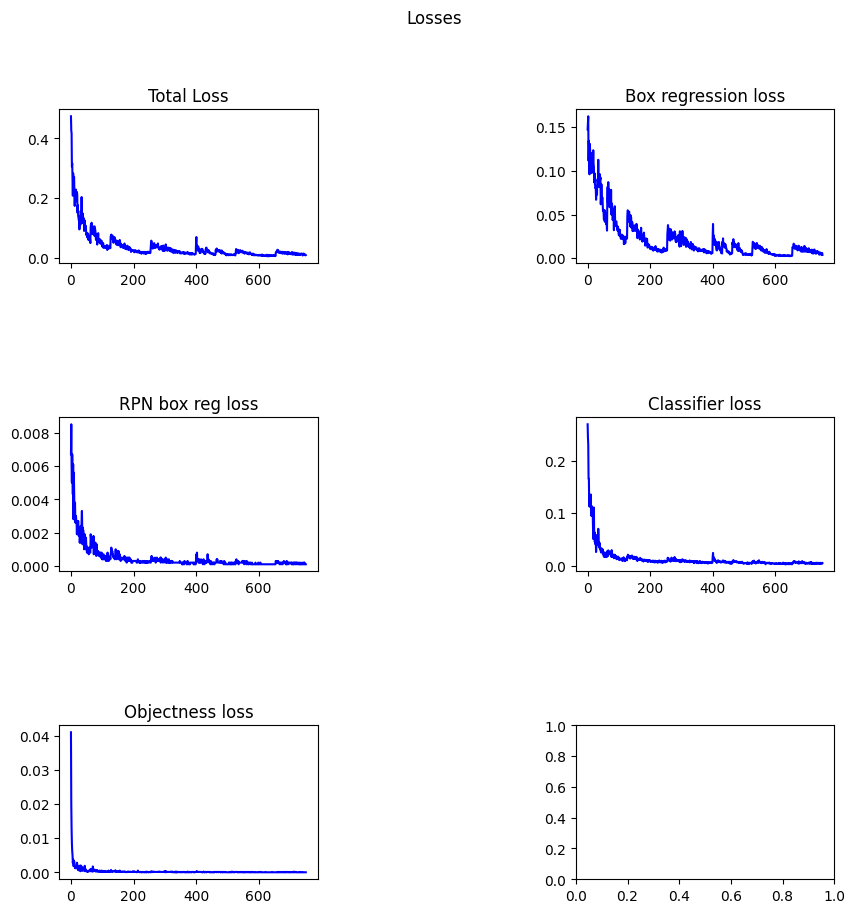

In [18]:
fig, axis = plt.subplots(3, 2, figsize = (10,10))
fig.subplots_adjust(hspace=1, wspace=1)

#plot 1:
plt.subplot(3, 2, 1)
plt.plot(losses, 'b')
plt.title("Total Loss")

#plot 2:
plt.subplot(3, 2, 2)
plt.plot(box_reg_loss,'b')
plt.title("Box regression loss")

#plot 3:
plt.subplot(3, 2, 3)
plt.plot(rpn_box_reg_loss,'b')
plt.title("RPN box reg loss")

#plot 4:
plt.subplot(3, 2, 4)
plt.plot(classifier_loss,'b')
plt.title("Classifier loss")

#plot 5:
plt.subplot(3, 2, 5)
plt.plot(objectness_loss,'b')
plt.title("Objectness loss")

plt.suptitle("Losses")

In [19]:
if torch.cuda.is_available():
    model1 = torch.load(r'../Saved_Model/train1000.pkl')
    model1.load_state_dict(torch.load('../Saved_Model/train1000.pth'))
else:
    model1 = torch.load(r'../Saved_Model/train1000.pkl',map_location=torch.device('cpu'))
    model1.load_state_dict(torch.load('../Saved_Model/train1000.pth',map_location=torch.device('cpu')))
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model1.to(device)
print("Model loaded!")

Model loaded!


In [20]:
def pred_and_nms(model, img, nms = False):
    model.eval()
    with torch.no_grad():
        prediction = model([img.to(device)])
    print(prediction)
    boxes = prediction[0]['boxes']
    scores = prediction[0]['scores']
    labels = prediction[0]['labels']
    if nms:
        keep = torchvision.ops.nms(boxes,scores,0.1)
        boxes = boxes.cpu().numpy().astype(np.float32)
        scores = scores.cpu().numpy().astype(np.float32)
        labels = labels.cpu().numpy().astype(np.int64)
        boxes_new = []
        scores_new = []
        labels_new = []
        for i in range(len(boxes)):
            if i in keep and scores[i] > 0.4:
                boxes_new.append(boxes[i])
                scores_new.append(scores[i])
                labels_new.append(labels[i])
        boxes_new = np.array(boxes_new)
        labels_new = np.array(labels_new)
        scores_new = np.array(scores_new)
        boxes = torch.as_tensor(boxes_new, dtype=torch.float32)
        labels = torch.as_tensor(labels_new, dtype=torch.int64)
        scores = torch.as_tensor(scores_new, dtype=torch.float32)
    return boxes, labels, scores

In [27]:
img, _ = dataset_test[21]

[{'boxes': tensor([[ 99.8352, 423.0037, 168.5071, 494.6178],
        [906.9160, 445.9583, 931.9033, 471.0189]]), 'labels': tensor([38,  2]), 'scores': tensor([0.9991, 0.9956])}]


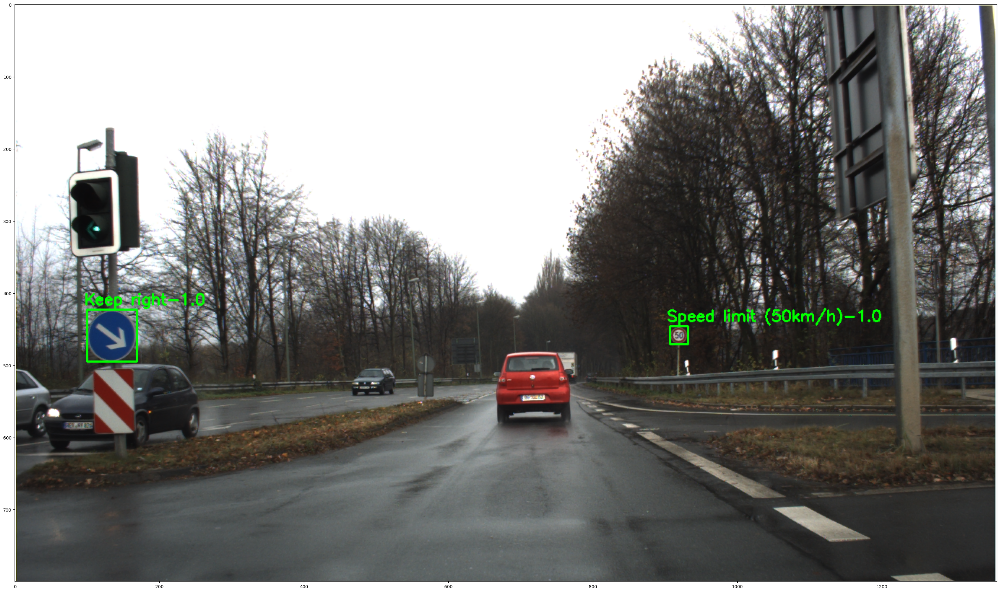

In [28]:
#image without non maximum suppression
boxes,labels,scores = pred_and_nms(model1,img)
image_w_bounding_box(img,boxes,labels,scores)

[{'boxes': tensor([[ 99.8352, 423.0037, 168.5071, 494.6178],
        [906.9160, 445.9583, 931.9033, 471.0189]]), 'labels': tensor([38,  2]), 'scores': tensor([0.9991, 0.9956])}]


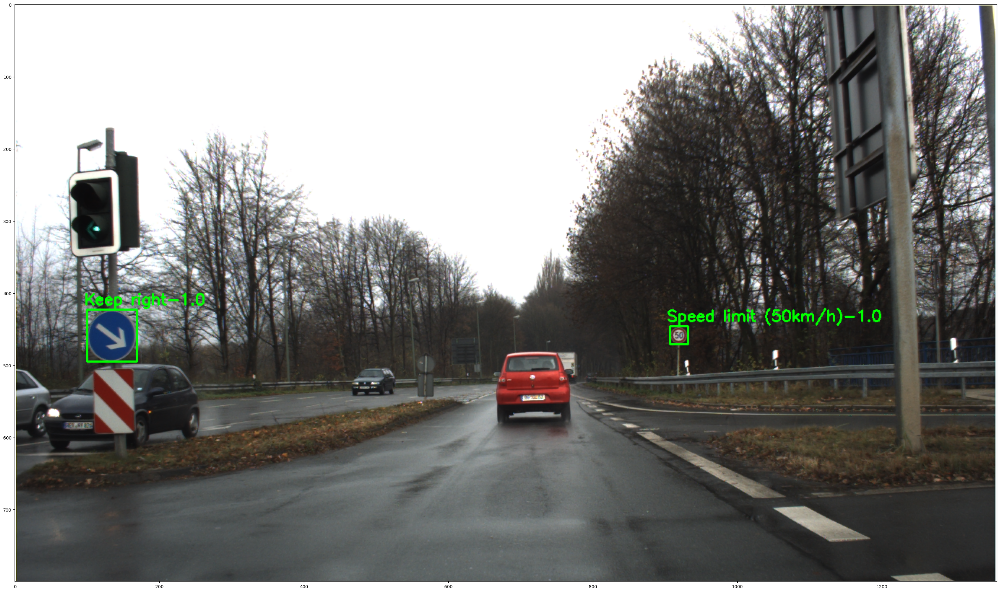

In [29]:
#image with non maximum suppression
boxes,labels,scores = pred_and_nms(model1,img, True)
image_w_bounding_box(img,boxes,labels,scores)

In [31]:
import cv2
import numpy as np
cap = cv2.VideoCapture('traffic_sign2.mp4')

frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
out = cv2.VideoWriter('output.avi', cv2.VideoWriter_fourcc('M','J','P','G'),25, (frame_width,frame_height))

while cap.isOpened():
    ret,frame = cap.read()
    if not ret:
        break
    frame = cv2.resize(frame, (1360,800))
    frameRGB = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
    img_np = np.array(frame)
    img_tensor = torch.from_numpy(img_np).permute(2, 0, 1)   #permute(1,2,0)
    img_tensor = img_tensor/255
    model1.eval()
    with torch.no_grad():
        prediction = model1([img_tensor.to(device)])

    boxes = prediction[0]['boxes']
    scores = prediction[0]['scores']
    labels = prediction[0]['labels']
    keep = torchvision.ops.nms(boxes,scores,0.1)
    boxes = boxes.cpu().numpy().astype(np.float32)
    scores = scores.cpu().numpy().astype(np.float32)
    labels = labels.cpu().numpy().astype(np.int64)
    for i in range(len(boxes)):
        if i in keep and scores[i] > 0.3:
            xmin = round(boxes[i][0])
            ymin = round(boxes[i][1])
            xmax = round(boxes[i][2])
            ymax = round(boxes[i][3])
            label = labels[i]

            #color = list(np.random.random(size=3)*256)
            colors = np.random.uniform(0, 255, size=(43, 3))

            if label in classes:
                pt1 = (xmin, ymin)
                pt2 = (xmax, ymax)
                score = scores[i]
                color = (0,255,0)
                cv2.rectangle(frame, pt1, pt2, color, thickness=2)
                cv2.putText(frame, classes[label]+"-"+str(round(score,2)), (xmin-15, ymin-7), cv2.FONT_HERSHEY_SIMPLEX, 0.7, color,
                            thickness=2)
    frame = cv2.resize(frame, (frame_width,frame_height))
    out.write(frame)

out.release()        
cap.release()